In [2]:
# ignore Warnings
import warnings
warnings.filterwarnings('ignore')

In [3]:
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
pip install pandas_profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.3/357.3 kB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 13.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 12.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 17.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 25.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 26.7 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=a3490a58f0663d9e1130521a709740e09eb174f6cf47315ca0a22f0687ee1876
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting uninstall: pydantic
    Found existing installation: pydantic 2.2.1
    Uninstalling pydantic-2.

In [4]:
import math, time, random, datetime

# data analysis and wrangling
import pandas as pd
import numpy as np
#from pandas_profiling import ProfileReport

In [5]:
# visualization
import seaborn as sns
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')

#import for interactive plotting
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
%matplotlib inline

In [ ]:
# Preprocessing
from sklearn.preprocessing import OneHotEncoder, LabelEncoder, label_binarize, StandardScaler

In [ ]:
# machine learning
from sklearn import model_selection, tree, preprocessing, metrics, linear_model
from sklearn.metrics import confusion_matrix,classification_report
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.model_selection import train_test_split,StratifiedKFold, GridSearchCV, learning_curve, cross_val_score

# Import and Inspect Data

In [6]:

import pandas as pd

# Path ke file CSV di Google Drive Anda
file_path = '/content/drive/My Drive/Stage 3/Dataset FinPro.csv'

# Membaca dataset CSV
df = pd.read_csv(file_path)

In [ ]:
list_item = []
for col in df.columns:
    list_item.append([col, df[col].dtype, df[col].isna().sum(), 100*df[col].isna().sum()/len(df[col]), df[col].nunique(), df[col].unique()[:4]])
desc_df = pd.DataFrame(data=list_item, columns='feature data_type null_num null_pct unique_num unique_sample'.split())
desc_df

,feature,data_type,null_num,null_pct,unique_num,unique_sample
0,Age,int64,0,0.0,43,"[41, 49, 37, 33]"
1,Attrition,object,0,0.0,2,"[Yes, No]"
2,BusinessTravel,object,0,0.0,3,"[Travel_Rarely, Travel_Frequently, Non-Travel]"
3,DailyRate,int64,0,0.0,886,"[1102, 279, 1373, 1392]"
4,Department,object,0,0.0,3,"[Sales, Research & Development, Human Resources]"
5,DistanceFromHome,int64,0,0.0,29,"[1, 8, 2, 3]"
6,Education,int64,0,0.0,5,"[2, 1, 4, 3]"
7,EducationField,object,0,0.0,6,"[Life Sciences, Other, Medical, Marketing]"
8,EmployeeCount,int64,0,0.0,1,[1]
9,EmployeeNumber,int64,0,0.0,1470,"[1, 2, 4, 5]"


In [ ]:
df.shape

(1470, 35)

## 1. DESCRIPTIVE STATISTICS

### Check Data Type

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

### Check value description

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,1470.0,36.923810,9.135373,18.0,30.00,36.0,43.00,60.0
DailyRate,1470.0,802.485714,403.509100,102.0,465.00,802.0,1157.00,1499.0
DistanceFromHome,1470.0,9.192517,8.106864,1.0,2.00,7.0,14.00,29.0
Education,1470.0,2.912925,1.024165,1.0,2.00,3.0,4.00,5.0
EmployeeCount,1470.0,1.000000,0.000000,1.0,1.00,1.0,1.00,1.0
EmployeeNumber,1470.0,1024.865306,602.024335,1.0,491.25,1020.5,1555.75,2068.0
EnvironmentSatisfaction,1470.0,2.721769,1.093082,1.0,2.00,3.0,4.00,4.0
HourlyRate,1470.0,65.891156,20.329428,30.0,48.00,66.0,83.75,100.0
JobInvolvement,1470.0,2.729932,0.711561,1.0,2.00,3.0,3.00,4.0
JobLevel,1470.0,2.063946,1.106940,1.0,1.00,2.0,3.00,5.0


In [ ]:
df.describe(exclude=[np.number]).T

,count,unique,top,freq
Attrition,1470,2,No,1233
BusinessTravel,1470,3,Travel_Rarely,1043
Department,1470,3,Research & Development,961
EducationField,1470,6,Life Sciences,606
Gender,1470,2,Male,882
JobRole,1470,9,Sales Executive,326
MaritalStatus,1470,3,Married,673
Over18,1470,1,Y,1470
OverTime,1470,2,No,1054


All good! It seems like no column has a strange value except 'EmployeeCount' and 'StandardHours' which only have 1 unique value. While for 'EmployeeNumber', we assumed that the number refers to the employee ID. The only reason why it has a higher number than the total current employees is that the missing IDs are those employees who no longer work at the company.

## 2. UNIVARIATE ANALYSIS

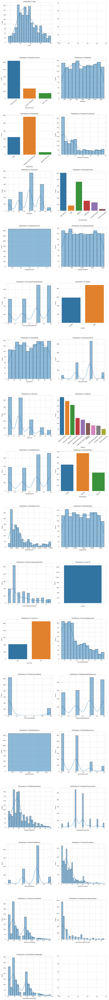

In [ ]:
# Mendefinisikan target
target = 'Attrition'

# Mengatur jumlah kolom dalam setiap baris subplot
columns_per_row = 2

# Menghitung jumlah total baris subplot yang dibutuhkan
total_rows = (len(df.columns) - 1) // columns_per_row + 1

# Membuat figure dengan ukuran yang sesuai
fig, axes = plt.subplots(total_rows, columns_per_row, figsize=(12, 6 * total_rows))

# Melakukan visualisasi untuk setiap kolom dalam dataset
for i, column in enumerate(df.columns):
    if column != target:
        # Menghitung posisi subplot
        subplot_row = i // columns_per_row
        subplot_col = i % columns_per_row

        # Mengatur subplot yang sedang aktif
        ax = axes[subplot_row, subplot_col]

        if df[column].dtype == 'object':
            # Jika kolom adalah tipe data kategorikal
            sns.countplot(data=df, x=column, ax=ax)
            ax.set_xticklabels(ax.get_xticklabels(), rotation=40)
        else:
            # Jika kolom adalah tipe data numerik
            sns.histplot(data=df, x=column, kde=True, ax=ax)

        ax.set_xlabel(column)
        ax.set_ylabel('Count')
        ax.set_title(f'Distribution of {column}')

# Menyembunyikan subplot yang tidak digunakan
#if len(features) % 2 != 0:
    #fig.delaxes(axes[-1])

plt.tight_layout()
plt.show()

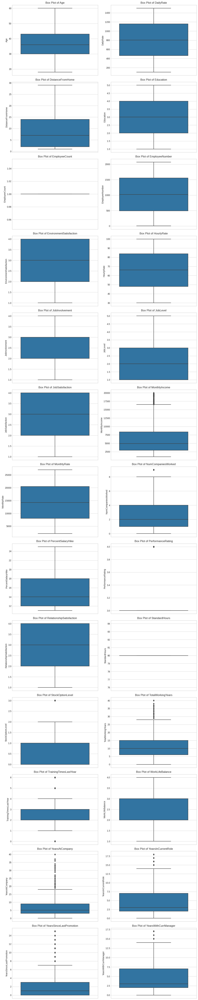

In [ ]:
# Mengatur ukuran dan tata letak subplot
fig, axes = plt.subplots(13, 2, figsize=(12, 60))

# Mengambil daftar fitur numerik
numeric_features = df.select_dtypes(include=['int64', 'float64']).columns

# Melakukan box plot untuk masing-masing fitur
for i, feature in enumerate(numeric_features):
    ax = axes[i // 2, i % 2]
    sns.boxplot(data=df, y=feature, ax=ax)
    ax.set_ylabel(feature)
    ax.set_title(f'Box Plot of {feature}')

# Menghilangkan subplot yang tidak digunakan
if len(numeric_features) % 2 != 0:
    axes[-1, -1].remove()

# Menampilkan plot
plt.tight_layout()
plt.show()

#### Hasil observasi: ####
- Terdapat distribusi data unimodal (Distribusi memiliki 1 titik peak) antara lain; Age, DistanceFromHome, MonthlyIncome, NumCompaniessWorked, YearsSinceLastPromotion, TotalWorkingYears, PercentSalaryHike, YearsAtCompany.
- Terdapat distribusi bimodal (Distribusi dengan 2 peak) antara lain; PerformanceRating, HourlyRate, MonthlyRate, TrainingTimesLastYear, YearsInCurrentRole, YearsWithCurrManager.
- Terdapat distribusi multimodal (Lebih dari 2 peak) antara lain; Education, EnvirontmentSatisfaction, JobInvolvement, JobLevel, JobSatisfaction, RelationshipSatisfaction, StockOptionLevel, WorkLifeBalance.
- Sementara itu, terdapat jenis distribusi berdasarkan skewnessnya antara lain; Normal(Age) dan Positively Skewed(DistanceFromHome, MonthlyIncome, NumCompaniessWorked, PercentSalaryHike, YearsSinceLastPromotion, TotalWorkingYears, YearsAtCompany)
- Terdapat outlier pada fitur MonthlyIncome, NumCompaniesWorked, PerformanceRating, StockOptionLevel, TotalWorkingYears, TrainingTimesLastYear, YearsAtCompany, YearsSinceLastPromotion & YearsWithCurrManager.

#### Rekomendasi untuk fase pre-processing: ####
- Perlu melakukan logtransformation pada fitur dengan jenis distribusi positively skewed
- Melakukan handling outlier dengan Z-score > 3 pada fitur-fitur yang memiliki outlier

## 3. MULTIVARIATE ANALYSIS

#### Tahap Feature Selection ####

Pada tahap ini, kami menggunakan Chi-Square test untuk melihat signifikansi fitur jenis kategorikal terhadap target 'Attrition'. Sementara untuk fitur numerical kami menggunakan Heatmap Correlation.

In [ ]:
import pandas as pd
from scipy.stats import chi2_contingency

categorical_features = ['Gender', 'BusinessTravel', 'Department', 'MaritalStatus', 'EducationField', 'JobRole', 'OverTime']
for feature in categorical_features:
    cross_tab = pd.crosstab(df[feature], df['Attrition'])
    chi2, p_value, dof, expected = chi2_contingency(cross_tab)

    print("Fitur:", feature)
    print("Chi-Square Statistic:", chi2)
    print("P-value:", p_value)
    print("")

    # Jika p-value kurang dari alpha (tingkat signifikansi), maka hipotesis nol ditolak, dan ada hubungan yang signifikan antara fitur dengan target 'Attrition'
    alpha = 0.05
    if p_value < alpha:
        print("Hubungan antara", feature, "dan Attrition SIGNIFIKAN.")
    else:
        print("Hubungan antara", feature, "dan Attrition TIDAK SIGNIFIKAN.")
    print("==========================================")

Fitur: Gender
Chi-Square Statistic: 1.1169671241970975
P-value: 0.29057244902890855

Hubungan antara Gender dan Attrition TIDAK SIGNIFIKAN.
Fitur: BusinessTravel
Chi-Square Statistic: 24.182413685655174
P-value: 5.608614476449931e-06

Hubungan antara BusinessTravel dan Attrition SIGNIFIKAN.
Fitur: Department
Chi-Square Statistic: 10.79600732241067
P-value: 0.004525606574479633

Hubungan antara Department dan Attrition SIGNIFIKAN.
Fitur: MaritalStatus
Chi-Square Statistic: 46.163676540848705
P-value: 9.45551106034083e-11

Hubungan antara MaritalStatus dan Attrition SIGNIFIKAN.
Fitur: EducationField
Chi-Square Statistic: 16.024674119585427
P-value: 0.006773980139025212

Hubungan antara EducationField dan Attrition SIGNIFIKAN.
Fitur: JobRole
Chi-Square Statistic: 86.19025367670434
P-value: 2.752481638050657e-15

Hubungan antara JobRole dan Attrition SIGNIFIKAN.
Fitur: OverTime
Chi-Square Statistic: 87.56429365828768
P-value: 8.15842372153832e-21

Hubungan antara OverTime dan Attrition SIG

#### Visualisasi Fitur Categorical Terhadap Attrition ####

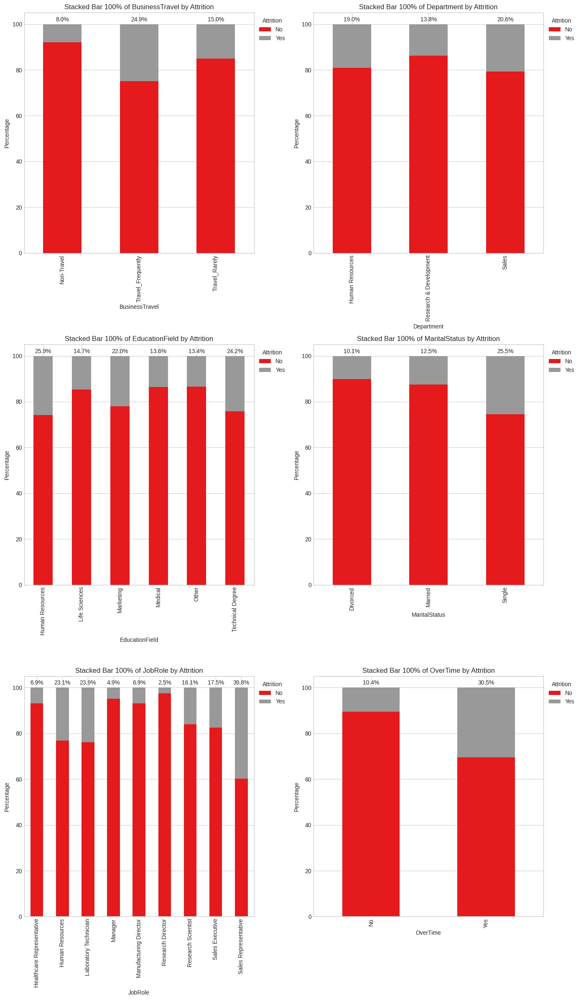

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Memilih hanya kolom-kolom kategorikal yang diinginkan
fitur_kategorikal = ['BusinessTravel', 'Department', 'EducationField', 'MaritalStatus', 'JobRole', 'OverTime']

# Menghitung jumlah subplot yang diperlukan
num_plots = len(fitur_kategorikal) // 2 + len(fitur_kategorikal) % 2

# Mengatur ukuran dan tata letak subplot
fig, axes = plt.subplots(num_plots, 2, figsize=(14, 8 * num_plots))
axes = axes.flatten()

# Melakukan stacked bar 100% untuk setiap fitur kategorikal
for i, feature in enumerate(fitur_kategorikal):
    stacked_data = df.groupby([feature, 'Attrition']).size().unstack()
    stacked_data = stacked_data.div(stacked_data.sum(axis=1), axis=0) * 100
    stacked_data.plot(kind='bar', stacked=True, ax=axes[i], colormap='Set1')
    axes[i].set_xlabel(feature)
    axes[i].set_ylabel('Percentage')
    axes[i].set_title(f'Stacked Bar 100% of {feature} by Attrition')
    axes[i].legend(title='Attrition', labels=['No', 'Yes'], loc='upper left', bbox_to_anchor=(1, 1))

    # Menambahkan keterangan prosentase hanya untuk 'Yes' di atas setiap bagian dari stacked bar
    for j, col in enumerate(stacked_data.columns):
        for idx, val in enumerate(stacked_data[col]):
            if col == 'Yes':
                total = stacked_data.iloc[idx].sum()
                axes[i].annotate(f'{val:.1f}%', xy=(idx, total), xytext=(idx, total + 2),
                                 ha='center', va='center', fontsize=10)

if len(fitur_kategorikal) % 2 != 0:
    fig.delaxes(axes[-1])

plt.tight_layout()
plt.show()

#### Visualisasi Fitur Numerical Terhadap Attrition ####

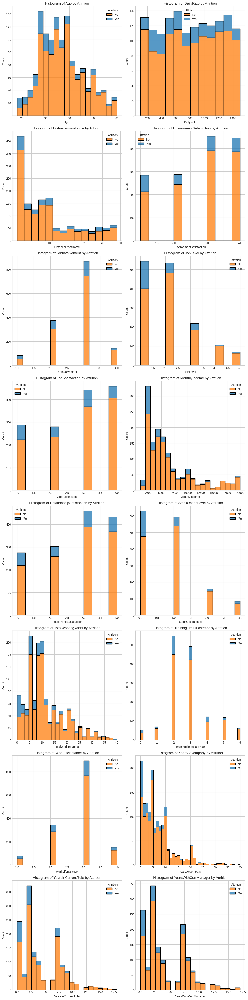

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Membaca dataset
df = pd.read_csv(file_path)

# Memilih hanya kolom-kolom numerik yang diinginkan
fitur_numerik = ['Age', 'DailyRate', 'DistanceFromHome', 'EnvironmentSatisfaction', 'JobInvolvement',
                 'JobLevel', 'JobSatisfaction', 'MonthlyIncome', 'RelationshipSatisfaction',
                 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear',
                 'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsWithCurrManager']

# Menghitung jumlah subplot yang diperlukan
num_plots = len(fitur_numerik) // 2 + len(fitur_numerik) % 2

# Mengatur ukuran dan tata letak subplot
fig, axes = plt.subplots(num_plots, 2, figsize=(12, 6 * num_plots))
axes = axes.flatten()

# Melakukan histogram untuk setiap fitur numerik
for i, feature in enumerate(fitur_numerik):
    sns.histplot(data=df, x=feature, hue='Attrition', multiple='stack', ax=axes[i])
    axes[i].set_xlabel(feature)
    axes[i].set_ylabel('Count')
    axes[i].set_title(f'Histogram of {feature} by Attrition')
    axes[i].legend(title='Attrition', labels=['No', 'Yes'])

# Menyembunyikan subplot yang tidak digunakan
if len(fitur_numerik) % 2 != 0:
    fig.delaxes(axes[-1])

# Menampilkan plot
plt.tight_layout()
plt.show()

Recommendations:
- Diperlukan encoding baik berupa Label Encoding maupun One-Hot Encoding pada fitur kategorikal yang akan digunakan seperti BusinessTravel, Department, EducationField, MaritalStatus, JobRole dan OverTime sebelum mengembangkan model.
- Terlihat bahwa StandardHours, EmployeeCount, EmployeeNumber dan Over18 hanya terdiri dari 1 jawaban sehingga tidak diperlukan sebagai fitur model.

# Data Summary

In [ ]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
df['Attrition'] = df['Attrition'].apply(lambda x:1 if x == "Yes" else 0 )
df['OverTime'] = df['OverTime'].apply(lambda x:1 if x =="Yes" else 0 )

In [ ]:
# Define visualization for categorical features

def categorical_column_viz(col_name):
    f, ax = plt.subplots(1, 2, figsize=(10, 6))

    # Count Plot
    df[col_name].value_counts().plot.bar(cmap='Set1', ax=ax[0])
    ax[0].set_title(f'Number of Employee by {col_name}')
    ax[0].set_ylabel('Count')
    ax[0].set_xlabel(f'{col_name}')

    # Attrition Count per factors
    sns.countplot(x=col_name, hue='Attrition', data=df, ax=ax[1], palette='Set1')
    ax[1].set_title(f'Attrition by {col_name}')
    ax[1].set_xlabel(f'{col_name}')
    ax[1].set_ylabel('Count')

In [ ]:
# Define visualization for numerical features

def numerical_column_viz(col_name):
    f,ax = plt.subplots(1,2, figsize=(18,6))
    sns.kdeplot(attrition[col_name], label='Employee who left',ax=ax[0], shade=True, color='palegreen')
    sns.kdeplot(no_attrition[col_name], label='Employee who stayed', ax=ax[0], shade=True, color='salmon')

    sns.boxplot(y=col_name, x='Attrition',data=df, palette='Set3', ax=ax[1])

## Extracting Features

In [ ]:
# drop the unnecessary columns (based EDA Stage 1)
df.drop(['EmployeeNumber','Over18','StandardHours','EmployeeCount', 'Gender'],axis=1,inplace=True)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 30 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   int64 
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EnvironmentSatisfaction   1470 non-null   int64 
 9   HourlyRate                1470 non-null   int64 
 10  JobInvolvement            1470 non-null   int64 
 11  JobLevel                  1470 non-null   int64 
 12  JobRole                   1470 non-null   object
 13  JobSatisfaction           1470 non-null   int64 
 14  MaritalStatus           

In [ ]:
# 'EnviornmentSatisfaction', 'JobInvolvement', 'JobSatisfacction', 'RelationshipSatisfaction', 'WorklifeBalance' can be clubbed into a single feature 'Accumulated_Satisfaction'

df['Accumulated_Satisfaction'] = (df['EnvironmentSatisfaction'] +
                            df['JobInvolvement'] +
                            df['JobSatisfaction'] +
                            df['RelationshipSatisfaction'] +
                            df['WorkLifeBalance']) /5

In [ ]:
attrition = df[df['Attrition'] == 1]
no_attrition = df[df['Attrition']==0]

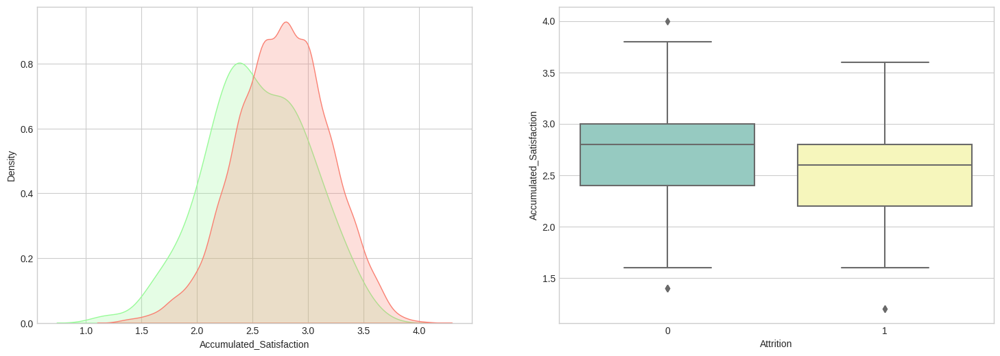

In [ ]:
numerical_column_viz('Accumulated_Satisfaction')

In [ ]:
df.Accumulated_Satisfaction.describe()

count    1470.000000
mean        2.730748
std         0.428551
min         1.200000
25%         2.400000
50%         2.800000
75%         3.000000
max         4.000000
Name: Accumulated_Satisfaction, dtype: float64

In [ ]:
df.corr()

,Age,Attrition,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,...,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Accumulated_Satisfaction
Age,1.000000,-0.159205,0.010661,-0.001686,0.208034,0.010146,0.024287,0.029820,0.509604,-0.004892,...,0.053535,0.037510,0.680381,-0.019621,-0.021490,0.311309,0.212901,0.216513,0.202089,0.032488
Attrition,-0.159205,1.000000,-0.056652,0.077924,-0.031373,-0.103369,-0.006846,-0.130016,-0.169105,-0.103481,...,-0.045872,-0.137145,-0.171063,-0.059478,-0.063939,-0.134392,-0.160545,-0.033019,-0.156199,-0.193395
DailyRate,0.010661,-0.056652,1.000000,-0.004985,-0.016806,0.018355,0.023381,0.046135,0.002966,0.030571,...,0.007846,0.042143,0.014515,0.002453,-0.037848,-0.034055,0.009932,-0.033229,-0.026363,0.031899
DistanceFromHome,-0.001686,0.077924,-0.004985,1.000000,0.021042,-0.016075,0.031131,0.008783,0.005303,-0.003669,...,0.006557,0.044872,0.004628,-0.036942,-0.026556,0.009508,0.018845,0.010029,0.014406,-0.012619
Education,0.208034,-0.031373,-0.016806,0.021042,1.000000,-0.027128,0.016775,0.042438,0.101589,-0.011296,...,-0.009118,0.018422,0.148280,-0.025100,0.009819,0.069114,0.060236,0.054254,0.069065,-0.006924
EnvironmentSatisfaction,0.010146,-0.103369,0.018355,-0.016075,-0.027128,1.000000,-0.049857,-0.008278,0.001212,-0.006784,...,0.007665,0.003432,-0.002693,-0.019359,0.027627,0.001458,0.018007,0.016194,-0.004999,0.516866
HourlyRate,0.024287,-0.006846,0.023381,0.031131,0.016775,-0.049857,1.000000,0.042861,-0.027853,-0.071335,...,0.001330,0.050263,-0.002334,-0.008548,-0.004607,-0.019582,-0.024106,-0.026716,-0.020123,-0.048763
JobInvolvement,0.029820,-0.130016,0.046135,0.008783,0.042438,-0.008278,0.042861,1.000000,-0.012630,-0.021476,...,0.034297,0.021523,-0.005533,-0.015338,-0.014617,-0.021355,0.008717,-0.024184,0.025976,0.329289
JobLevel,0.509604,-0.169105,0.002966,0.005303,0.101589,0.001212,-0.027853,-0.012630,1.000000,-0.001944,...,0.021642,0.013984,0.782208,-0.018191,0.037818,0.534739,0.389447,0.353885,0.375281,0.018812
JobSatisfaction,-0.004892,-0.103481,0.030571,-0.003669,-0.011296,-0.006784,-0.071335,-0.021476,-0.001944,1.000000,...,-0.012454,0.010690,-0.020185,-0.005779,-0.019459,-0.003803,-0.002305,-0.018214,-0.027656,0.491394


In [ ]:
# Because Accumulated_Satisfaction has higher correlation to Attrition compared to its constituents, then we consider to drop them all

df.drop(['EnvironmentSatisfaction', 'JobInvolvement', 'JobSatisfaction', 'RelationshipSatisfaction', 'WorkLifeBalance'],axis=1,inplace=True)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 26 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Age                       1470 non-null   int64  
 1   Attrition                 1470 non-null   int64  
 2   BusinessTravel            1470 non-null   object 
 3   DailyRate                 1470 non-null   int64  
 4   Department                1470 non-null   object 
 5   DistanceFromHome          1470 non-null   int64  
 6   Education                 1470 non-null   int64  
 7   EducationField            1470 non-null   object 
 8   HourlyRate                1470 non-null   int64  
 9   JobLevel                  1470 non-null   int64  
 10  JobRole                   1470 non-null   object 
 11  MaritalStatus             1470 non-null   object 
 12  MonthlyIncome             1470 non-null   int64  
 13  MonthlyRate               1470 non-null   int64  
 14  NumCompa

In [ ]:
# Extract new feature #2 'YearsWorkingPerCompany'

df['YearsWorkingPerCompany'] = df['TotalWorkingYears'] / df['NumCompaniesWorked']
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,HourlyRate,JobLevel,...,PerformanceRating,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Accumulated_Satisfaction,YearsWorkingPerCompany
0,41,1,Travel_Rarely,1102,Sales,1,2,Life Sciences,94,2,...,3,0,8,0,6,4,0,5,2.2,1.000000
1,49,0,Travel_Frequently,279,Research & Development,8,1,Life Sciences,61,2,...,4,1,10,3,10,7,1,7,2.8,10.000000
2,37,1,Travel_Rarely,1373,Research & Development,2,2,Other,92,1,...,3,0,7,3,0,0,0,0,2.8,1.166667
3,33,0,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,56,1,...,3,0,8,3,8,7,3,0,3.2,8.000000
4,27,0,Travel_Rarely,591,Research & Development,2,1,Medical,40,1,...,3,1,6,3,2,2,2,2,2.6,0.666667


In [ ]:
df['YearsWorkingPerCompany'].describe()

count    1470.000000
mean             inf
std              NaN
min         0.000000
25%         2.166667
50%         5.000000
75%        10.000000
max              inf
Name: YearsWorkingPerCompany, dtype: float64

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 27 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Age                       1470 non-null   int64  
 1   Attrition                 1470 non-null   int64  
 2   BusinessTravel            1470 non-null   object 
 3   DailyRate                 1470 non-null   int64  
 4   Department                1470 non-null   object 
 5   DistanceFromHome          1470 non-null   int64  
 6   Education                 1470 non-null   int64  
 7   EducationField            1470 non-null   object 
 8   HourlyRate                1470 non-null   int64  
 9   JobLevel                  1470 non-null   int64  
 10  JobRole                   1470 non-null   object 
 11  MaritalStatus             1470 non-null   object 
 12  MonthlyIncome             1470 non-null   int64  
 13  MonthlyRate               1470 non-null   int64  
 14  NumCompa

In [ ]:
# Karena terdapat data pada fitur YearsWorkingPerCompany berupa inf, maka akan dilakukan modif pada fitur NumCompaniesWorked, TotalWorkingYears, dan YearsAtCOmpany

df.drop(df[(df['NumCompaniesWorked'] == 0) & (df['YearsAtCompany'] != df['TotalWorkingYears'])].index, axis=0, inplace=True)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1273 entries, 0 to 1469
Data columns (total 27 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Age                       1273 non-null   int64  
 1   Attrition                 1273 non-null   int64  
 2   BusinessTravel            1273 non-null   object 
 3   DailyRate                 1273 non-null   int64  
 4   Department                1273 non-null   object 
 5   DistanceFromHome          1273 non-null   int64  
 6   Education                 1273 non-null   int64  
 7   EducationField            1273 non-null   object 
 8   HourlyRate                1273 non-null   int64  
 9   JobLevel                  1273 non-null   int64  
 10  JobRole                   1273 non-null   object 
 11  MaritalStatus             1273 non-null   object 
 12  MonthlyIncome             1273 non-null   int64  
 13  MonthlyRate               1273 non-null   int64  
 14  NumCompa

In [ ]:
df['YearsWorkingPerCompany'].describe()

count    1273.000000
mean        5.649048
std         5.324160
min         0.000000
25%         2.000000
50%         4.000000
75%         8.000000
max        40.000000
Name: YearsWorkingPerCompany, dtype: float64

In [ ]:
attrition = df[df['Attrition'] == 1]
no_attrition = df[df['Attrition']==0]

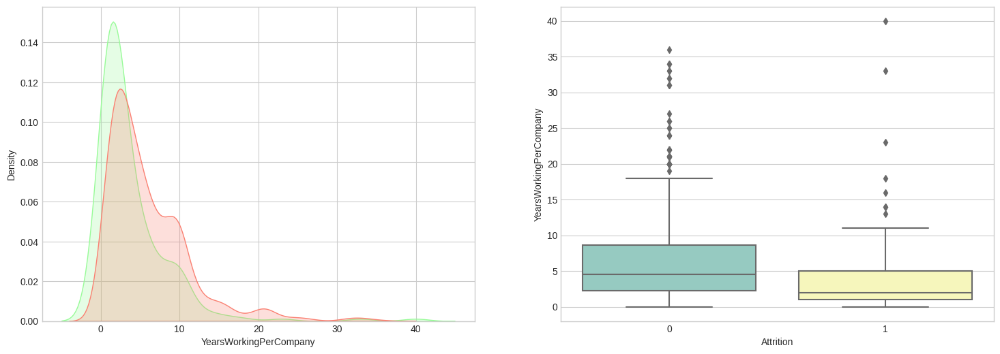

In [ ]:
numerical_column_viz('YearsWorkingPerCompany')

## Data Cleaning

Berdasarkan EDA (Stage 1) sebelumnya, maka akan dilakukan data cleansing sebagai berikut :

1. Missing value: There's **no missing value in dataset**
2. Duplicates: There's **no duplicates in dataset**
3. Handle Outliers: **handling outlier with zscore > 3**
4. Feature transformation: **perform transfor log1p for positive skewed distribution features**

In [ ]:
#Transform Possitively Skewed Features
positively_skewed_features = ['DistanceFromHome', 'MonthlyIncome', 'TotalWorkingYears',
                         'YearsAtCompany', 'YearsInCurrentRole', 'YearsWithCurrManager','PercentSalaryHike', 'YearsWorkingPerCompany']

# Log-transform the positively skewed features
for feature in positively_skewed_features:
    df[feature] = np.log1p(df[feature])

# Check the resulting DataFrame
print(df.head())

   Age  Attrition     BusinessTravel  DailyRate              Department  \
0   41          1      Travel_Rarely       1102                   Sales   
1   49          0  Travel_Frequently        279  Research & Development   
2   37          1      Travel_Rarely       1373  Research & Development   
3   33          0  Travel_Frequently       1392  Research & Development   
4   27          0      Travel_Rarely        591  Research & Development   

   DistanceFromHome  Education EducationField  HourlyRate  JobLevel  ...  \
0          0.693147          2  Life Sciences          94         2  ...   
1          2.197225          1  Life Sciences          61         2  ...   
2          1.098612          2          Other          92         1  ...   
3          1.386294          4  Life Sciences          56         1  ...   
4          1.098612          1        Medical          40         1  ...   

  PerformanceRating StockOptionLevel  TotalWorkingYears  \
0                 3              

In [ ]:
df[positively_skewed_features].describe().T

,count,mean,std,min,25%,50%,75%,max
DistanceFromHome,1273.0,1.994113,0.853943,0.693147,1.098612,2.079442,2.708050,3.401197
MonthlyIncome,1273.0,8.564473,0.674585,6.917706,7.976595,8.530702,9.062072,9.902187
TotalWorkingYears,1273.0,2.314648,0.715425,0.000000,1.945910,2.397895,2.833213,3.713572
YearsAtCompany,1273.0,1.780298,0.767731,0.000000,1.098612,1.791759,2.397895,3.713572
YearsInCurrentRole,1273.0,1.350212,0.809814,0.000000,1.098612,1.386294,2.079442,2.944439
YearsWithCurrManager,1273.0,1.317630,0.820137,0.000000,1.098612,1.386294,2.079442,2.890372
PercentSalaryHike,1273.0,2.760734,0.215061,2.484907,2.564949,2.708050,2.944439,3.258097
YearsWorkingPerCompany,1273.0,1.636734,0.710524,0.000000,1.098612,1.609438,2.197225,3.713572


### Handling Outliers

In [ ]:
# Step 1: Calculate Z-scores for each feature
z_scores = pd.DataFrame()
for col in df.columns:
    if df[col].dtype in [int, float]:
        z_scores[col] = (df[col] - df[col].mean()) / df[col].std()

# Step 2: Identify rows with Z-scores greater than a threshold (e.g., 3 or -3)
threshold = 3
outlier_flags_zscore = (z_scores.abs() > threshold).any(axis=1)

# Step 3: Calculate the IQR for each feature
q1 = df.quantile(0.25)
q3 = df.quantile(0.75)
iqr = q3 - q1

# Step 4: Define the upper and lower bounds for outliers using IQR method
lower_bound_iqr = q1 - 1.5 * iqr
upper_bound_iqr = q3 + 1.5 * iqr

# Step 5: Identify rows with values outside the bounds (IQR method)
outlier_flags_iqr = ((df < lower_bound_iqr) | (df > upper_bound_iqr)).any(axis=1)

# Check the number of rows before and after handling outliers for both techniques
print("Number of rows before handling outliers (Original):", len(df))
print("Number of rows after handling outliers (Z-score method):", len(df[~outlier_flags_zscore]))
print("Number of rows after handling outliers (IQR method):", len(df[~outlier_flags_iqr]))

Number of rows before handling outliers (Original): 1273
Number of rows after handling outliers (Z-score method): 1220
Number of rows after handling outliers (IQR method): 576


**Decided to use z-score method**

In [ ]:
# Remove the rows with flagged Z-scores (outliers)
df = df[~outlier_flags_zscore]

# Check the resulting DataFrame after removing outliers
print(df.head())

   Age  Attrition     BusinessTravel  DailyRate              Department  \
0   41          1      Travel_Rarely       1102                   Sales   
1   49          0  Travel_Frequently        279  Research & Development   
2   37          1      Travel_Rarely       1373  Research & Development   
3   33          0  Travel_Frequently       1392  Research & Development   
4   27          0      Travel_Rarely        591  Research & Development   

   DistanceFromHome  Education EducationField  HourlyRate  JobLevel  ...  \
0          0.693147          2  Life Sciences          94         2  ...   
1          2.197225          1  Life Sciences          61         2  ...   
2          1.098612          2          Other          92         1  ...   
3          1.386294          4  Life Sciences          56         1  ...   
4          1.098612          1        Medical          40         1  ...   

  PerformanceRating StockOptionLevel  TotalWorkingYears  \
0                 3              

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,1220.0,37.217213,9.082497,19.000000,30.000000,36.000000,43.000000,60.000000
Attrition,1220.0,0.165574,0.371850,0.000000,0.000000,0.000000,0.000000,1.000000
DailyRate,1220.0,807.610656,400.811198,102.000000,469.750000,810.000000,1162.000000,1498.000000
DistanceFromHome,1220.0,1.992732,0.855194,0.693147,1.098612,2.079442,2.708050,3.401197
Education,1220.0,2.934426,1.014559,1.000000,2.000000,3.000000,4.000000,5.000000
HourlyRate,1220.0,65.895902,20.227212,30.000000,48.000000,66.000000,83.000000,100.000000
JobLevel,1220.0,2.050820,1.081142,1.000000,1.000000,2.000000,3.000000,5.000000
MonthlyIncome,1220.0,8.550545,0.654078,6.917706,7.982502,8.517993,8.985915,9.902187
MonthlyRate,1220.0,14286.218852,7101.314540,2094.000000,8191.750000,14235.500000,20440.500000,26999.000000
NumCompaniesWorked,1220.0,3.125410,2.437372,1.000000,1.000000,2.000000,4.000000,9.000000


### Encode Categorical Features

In [ ]:
# We will encode the selected categorical features

features_to_onehot_encode = ['BusinessTravel', 'Department', 'EducationField',
                            'MaritalStatus', 'JobRole']

# One-hot encode the selected features
df = pd.get_dummies(df, columns=features_to_onehot_encode)
df.head()

,Age,Attrition,DailyRate,DistanceFromHome,Education,HourlyRate,JobLevel,MonthlyIncome,MonthlyRate,NumCompaniesWorked,...,MaritalStatus_Single,JobRole_Healthcare Representative,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative
0,41,1,1102,1,2,94,2,5993,19479,8,...,1,0,0,0,0,0,0,0,1,0
1,49,0,279,8,1,61,2,5130,24907,1,...,0,0,0,0,0,0,0,1,0,0
2,37,1,1373,2,2,92,1,2090,2396,6,...,1,0,0,1,0,0,0,0,0,0
3,33,0,1392,3,4,56,1,2909,23159,1,...,0,0,0,0,0,0,0,1,0,0
4,27,0,591,2,1,40,1,3468,16632,9,...,0,0,0,1,0,0,0,0,0,0


In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,1220.0,37.217213,9.082497,19.000000,30.000000,36.000000,43.000000,60.000000
Attrition,1220.0,0.165574,0.371850,0.000000,0.000000,0.000000,0.000000,1.000000
DailyRate,1220.0,807.610656,400.811198,102.000000,469.750000,810.000000,1162.000000,1498.000000
DistanceFromHome,1220.0,1.992732,0.855194,0.693147,1.098612,2.079442,2.708050,3.401197
Education,1220.0,2.934426,1.014559,1.000000,2.000000,3.000000,4.000000,5.000000
HourlyRate,1220.0,65.895902,20.227212,30.000000,48.000000,66.000000,83.000000,100.000000
JobLevel,1220.0,2.050820,1.081142,1.000000,1.000000,2.000000,3.000000,5.000000
MonthlyIncome,1220.0,8.550545,0.654078,6.917706,7.982502,8.517993,8.985915,9.902187
MonthlyRate,1220.0,14286.218852,7101.314540,2094.000000,8191.750000,14235.500000,20440.500000,26999.000000
NumCompaniesWorked,1220.0,3.125410,2.437372,1.000000,1.000000,2.000000,4.000000,9.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1220 entries, 0 to 1469
Data columns (total 46 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Age                                1220 non-null   int64  
 1   Attrition                          1220 non-null   int64  
 2   DailyRate                          1220 non-null   int64  
 3   DistanceFromHome                   1220 non-null   float64
 4   Education                          1220 non-null   int64  
 5   HourlyRate                         1220 non-null   int64  
 6   JobLevel                           1220 non-null   int64  
 7   MonthlyIncome                      1220 non-null   float64
 8   MonthlyRate                        1220 non-null   int64  
 9   NumCompaniesWorked                 1220 non-null   int64  
 10  OverTime                           1220 non-null   int64  
 11  PercentSalaryHike                  1220 non-null   float

### Feature Selection

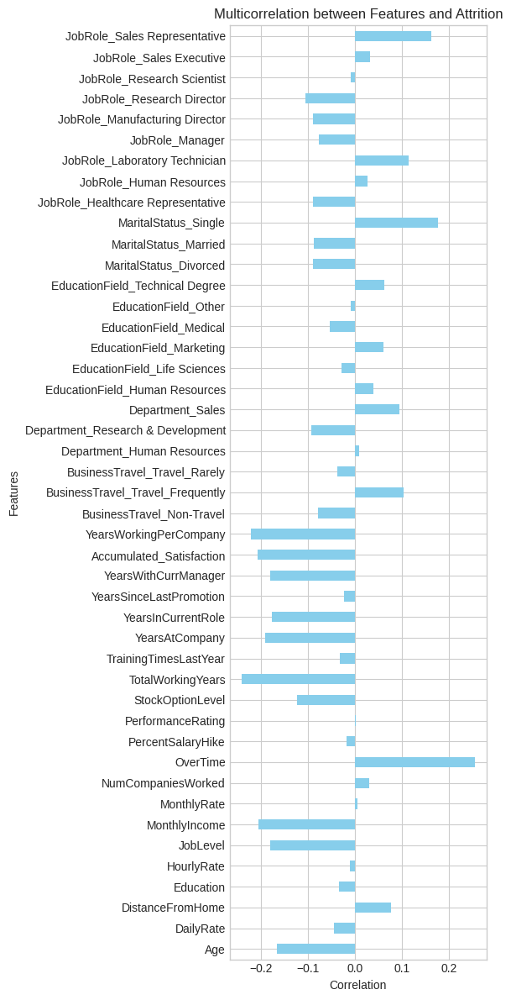

In [ ]:
# Pilih kolom target (attrition) dan hitung korelasi dengan setiap fitur
correlations = df.drop(columns=['Attrition']).apply(lambda x: x.corr(df['Attrition']))

# Buat bar plot vertikal untuk visualisasi multicorrelation
plt.figure(figsize=(6, 12))
correlations.plot(kind='barh', color='skyblue')
plt.title('Multicorrelation between Features and Attrition')
plt.ylabel('Features')
plt.xlabel('Correlation')
plt.tight_layout()
plt.show()

In [ ]:
# Hitung korelasi antara fitur-fitur dengan target 'attrition'
correlations = df.drop(columns=['Attrition']).corrwith(df['Attrition']).reset_index()
correlations.columns = ['Feature', 'Correlation']

# Tampilkan DataFrame dengan nilai korelasi
print(correlations)

                              Feature  Correlation
0                                 Age    -0.166112
1                           DailyRate    -0.044393
2                    DistanceFromHome     0.076045
3                           Education    -0.034257
4                          HourlyRate    -0.011885
5                            JobLevel    -0.180110
6                       MonthlyIncome    -0.206181
7                         MonthlyRate     0.005485
8                  NumCompaniesWorked     0.029568
9                            OverTime     0.254790
10                  PercentSalaryHike    -0.018390
11                  PerformanceRating     0.001271
12                   StockOptionLevel    -0.124181
13                  TotalWorkingYears    -0.241572
14              TrainingTimesLastYear    -0.032024
15                     YearsAtCompany    -0.190886
16                 YearsInCurrentRole    -0.177568
17            YearsSinceLastPromotion    -0.023553
18               YearsWithCurrM

In [ ]:
# Hitung korelasi antara fitur-fitur dengan target 'attrition'
correlations = df.drop(columns=['Attrition']).corrwith(df['Attrition']).reset_index()
correlations.columns = ['Feature', 'Correlation']

# Tentukan threshold korelasi yang ingin Anda gunakan
threshold_1 = 0.05
threshold_2 = 0.07

# Seleksi fitur berdasarkan threshold
selected_features_1 = correlations[abs(correlations['Correlation']) >= threshold_1]
selected_features_2 = correlations[abs(correlations['Correlation']) >= threshold_2]

# Jumlah fitur yang bertahan
num_selected_features_1 = len(selected_features_1)
num_selected_features_2 = len(selected_features_2)

print(f"Jumlah fitur yang bertahan dengan threshold {threshold_1}: {num_selected_features_1}")
print(f"Jumlah fitur yang bertahan dengan threshold {threshold_2}: {num_selected_features_2}")

Jumlah fitur yang bertahan dengan threshold 0.05: 28
Jumlah fitur yang bertahan dengan threshold 0.07: 25


Kami memutuskan untuk menggunakan threshold 0.07 (absolut)

In [ ]:
# Hitung korelasi antara fitur-fitur dengan target 'attrition'
correlations = df.drop(columns=['Attrition']).corrwith(df['Attrition']).reset_index()
correlations.columns = ['Feature', 'Correlation']

# Tentukan threshold korelasi yang ingin Anda gunakan
threshold = 0.07

# Seleksi fitur berdasarkan threshold
selected_features = correlations[abs(correlations['Correlation']) >= threshold]

# Dapatkan daftar fitur yang lolos seleksi dalam bentuk array
selected_feature_array = selected_features['Feature'].values

print("Fitur yang lolos seleksi dengan threshold 0.07 absolut:")
print(selected_feature_array)

Fitur yang lolos seleksi dengan threshold 0.07 absolut:
['Age' 'DistanceFromHome' 'JobLevel' 'MonthlyIncome' 'OverTime'
 'StockOptionLevel' 'TotalWorkingYears' 'YearsAtCompany'
 'YearsInCurrentRole' 'YearsWithCurrManager' 'Accumulated_Satisfaction'
 'YearsWorkingPerCompany' 'BusinessTravel_Non-Travel'
 'BusinessTravel_Travel_Frequently' 'Department_Research & Development'
 'Department_Sales' 'MaritalStatus_Divorced' 'MaritalStatus_Married'
 'MaritalStatus_Single' 'JobRole_Healthcare Representative'
 'JobRole_Laboratory Technician' 'JobRole_Manager'
 'JobRole_Manufacturing Director' 'JobRole_Research Director'
 'JobRole_Sales Representative']


In [ ]:
# Hitung korelasi antara fitur-fitur dengan target 'attrition'
correlations = df.drop(columns=['Attrition']).corrwith(df['Attrition']).reset_index()
correlations.columns = ['Feature', 'Correlation']

# Tentukan threshold korelasi yang ingin Anda gunakan
threshold = 0.07

# Seleksi fitur berdasarkan threshold
selected_features = correlations[abs(correlations['Correlation']) >= threshold]

# Dapatkan daftar fitur yang lolos seleksi dalam bentuk array
selected_feature_array = selected_features['Feature'].values

# Dapatkan daftar fitur yang tidak lolos seleksi
dropped_features = df.drop(columns=['Attrition']).columns.difference(selected_feature_array)

print("Fitur yang tidak lolos seleksi dengan threshold 0.07 absolut:")
print(dropped_features)

Fitur yang tidak lolos seleksi dengan threshold 0.07 absolut:
Index(['BusinessTravel_Travel_Rarely', 'DailyRate',
       'Department_Human Resources', 'Education',
       'EducationField_Human Resources', 'EducationField_Life Sciences',
       'EducationField_Marketing', 'EducationField_Medical',
       'EducationField_Other', 'EducationField_Technical Degree', 'HourlyRate',
       'JobRole_Human Resources', 'JobRole_Research Scientist',
       'JobRole_Sales Executive', 'MonthlyRate', 'NumCompaniesWorked',
       'PercentSalaryHike', 'PerformanceRating', 'TrainingTimesLastYear',
       'YearsSinceLastPromotion'],
      dtype='object')


In [ ]:
features_drop =['BusinessTravel_Travel_Rarely', 'DailyRate',
                   'Department_Human Resources', 'Education',
                   'EducationField_Human Resources', 'EducationField_Life Sciences',
                   'EducationField_Marketing', 'EducationField_Medical',
                   'EducationField_Other', 'EducationField_Technical Degree', 'HourlyRate',
                   'JobRole_Human Resources', 'JobRole_Research Scientist',
                   'JobRole_Sales Executive', 'MonthlyRate', 'NumCompaniesWorked',
                   'PercentSalaryHike', 'PerformanceRating', 'TrainingTimesLastYear',
                   'YearsSinceLastPromotion'
                    ]
len(features_drop)

20

In [ ]:
data = df.drop(columns=['BusinessTravel_Travel_Rarely', 'DailyRate',
                   'Department_Human Resources', 'Education',
                   'EducationField_Human Resources', 'EducationField_Life Sciences',
                   'EducationField_Marketing', 'EducationField_Medical',
                   'EducationField_Other', 'EducationField_Technical Degree', 'HourlyRate',
                   'JobRole_Human Resources', 'JobRole_Research Scientist',
                   'JobRole_Sales Executive', 'MonthlyRate', 'NumCompaniesWorked',
                   'PercentSalaryHike', 'PerformanceRating', 'TrainingTimesLastYear',
                   'YearsSinceLastPromotion'
                    ])
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1220 entries, 0 to 1469
Data columns (total 26 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Age                                1220 non-null   int64  
 1   Attrition                          1220 non-null   int64  
 2   DistanceFromHome                   1220 non-null   float64
 3   JobLevel                           1220 non-null   int64  
 4   MonthlyIncome                      1220 non-null   float64
 5   OverTime                           1220 non-null   int64  
 6   StockOptionLevel                   1220 non-null   int64  
 7   TotalWorkingYears                  1220 non-null   float64
 8   YearsAtCompany                     1220 non-null   float64
 9   YearsInCurrentRole                 1220 non-null   float64
 10  YearsWithCurrManager               1220 non-null   float64
 11  Accumulated_Satisfaction           1220 non-null   float

In [ ]:
from sklearn.preprocessing import StandardScaler

# Membuat variabel nums
nums   = ['Age', 'DistanceFromHome', 'JobLevel', 'MonthlyIncome' ,
 'StockOptionLevel', 'TotalWorkingYears', 'YearsAtCompany',
 'YearsInCurrentRole', 'YearsWithCurrManager', 'Accumulated_Satisfaction',
 'YearsWorkingPerCompany']

# Melakukan proses scaling
for num in nums:
    data[num] = StandardScaler().fit_transform(data[num].values.reshape(len(df), 1))

In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,1220.0,3.538153e-16,1.000410,-2.006572,-0.794955,-0.134072,0.636957,2.509456
Attrition,1220.0,1.655738e-01,0.371850,0.000000,0.000000,0.000000,0.000000,1.000000
DistanceFromHome,1220.0,1.863719e-16,1.000410,-1.520260,-1.045945,0.101433,0.836783,1.647630
JobLevel,1220.0,1.616194e-16,1.000410,-0.972352,-0.972352,-0.047025,0.878303,2.728958
MonthlyIncome,1220.0,3.552714e-15,1.000410,-2.497423,-0.868820,-0.049788,0.665898,2.067333
OverTime,1220.0,2.860656e-01,0.452106,0.000000,0.000000,0.000000,1.000000,1.000000
StockOptionLevel,1220.0,5.241709e-17,1.000410,-0.945423,-0.945423,0.225558,0.225558,2.567520
TotalWorkingYears,1220.0,3.334309e-16,1.000410,-2.393160,-0.533937,0.136853,0.692934,1.976675
YearsAtCompany,1220.0,4.346250e-16,1.000410,-2.427947,-0.909760,0.048109,0.754026,2.562029
YearsInCurrentRole,1220.0,-6.697739e-17,1.000410,-1.684654,-0.297660,0.065538,0.940635,1.964432


### Handle Imbalance Class Target

#### SMOTE

In [ ]:
# Membagi data menjadi target dan fitur
x = data[[col for col in data.columns if col not in ['Attrition']]]
y = data['Attrition'].values

print("Jumlah perbandingan antara kelas attrition dan tidak attrition sebelum class imbalance :")
print(pd.Series(y).value_counts())

Jumlah perbandingan antara kelas attrition dan tidak attrition sebelum class imbalance :
0    1018
1     202
dtype: int64


In [ ]:
# Melakukan handling class imbalance
from imblearn import over_sampling
X_smote, y_smote = over_sampling.SMOTE(sampling_strategy = 1).fit_resample(x, y)

print("Jumlah perbandingan antara kelas attrition dan tidak attrition setelah class imbalance :")
print(pd.Series(y_smote).value_counts())

Jumlah perbandingan antara kelas attrition dan tidak attrition setelah class imbalance :
1    1018
0    1018
dtype: int64


In [ ]:
# Menggabungkan kembali data setelah dilakukan handling class imbalance
datafix= X_smote
datafix['Attrition'] = y_smote
datafix.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2036 entries, 0 to 2035
Data columns (total 26 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Age                                2036 non-null   float64
 1   DistanceFromHome                   2036 non-null   float64
 2   JobLevel                           2036 non-null   float64
 3   MonthlyIncome                      2036 non-null   float64
 4   OverTime                           2036 non-null   int64  
 5   StockOptionLevel                   2036 non-null   float64
 6   TotalWorkingYears                  2036 non-null   float64
 7   YearsAtCompany                     2036 non-null   float64
 8   YearsInCurrentRole                 2036 non-null   float64
 9   YearsWithCurrManager               2036 non-null   float64
 10  Accumulated_Satisfaction           2036 non-null   float64
 11  YearsWorkingPerCompany             2036 non-null   float

In [ ]:
# Melakukan pemisahan antara fitur dengan target
X = datafix.drop(columns=['Attrition'])
y = datafix[['Attrition']]

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 42)

## Modelling

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, fbeta_score, confusion_matrix, classification_report, roc_auc_score, make_scorer

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 635, number of negative: 647
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000427 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2060
[LightGBM] [Info] Number of data points in the train set: 1282, number of used features: 25
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495320 -> initscore=-0.018721
[LightGBM] [Info] Start training from score -0.018721
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 635, number of negative: 647
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000177 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_

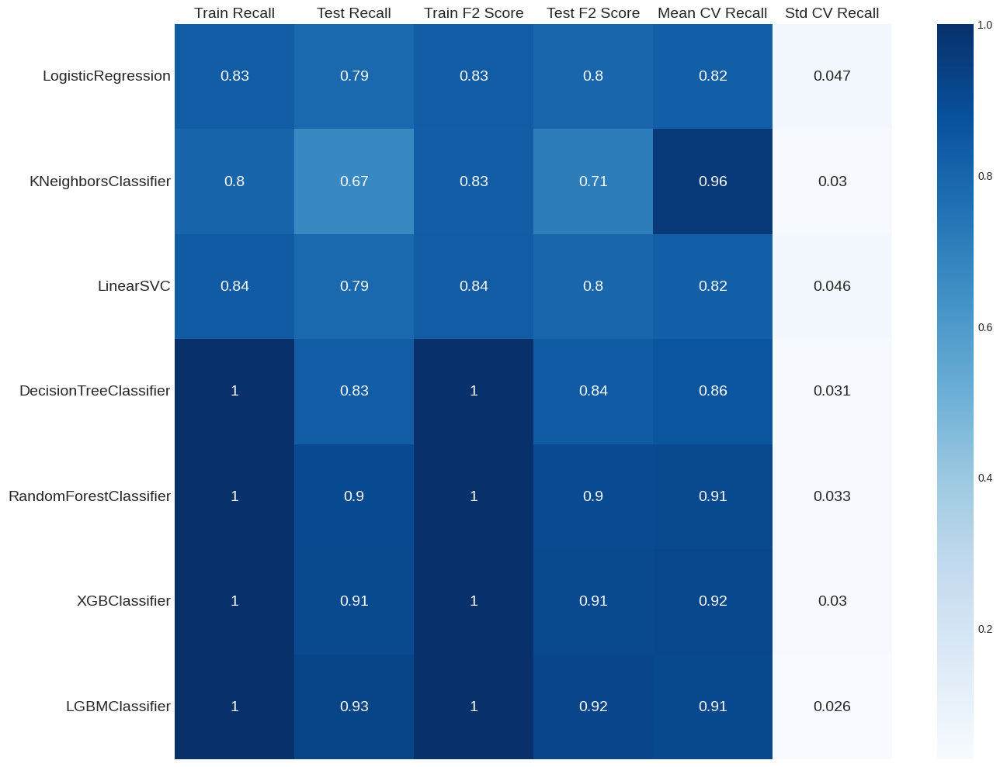

In [ ]:
from sklearn.model_selection import cross_val_score, StratifiedKFold

def createmodel(X_train, X_test, y_train, y_test, models):
    performance = []
    model_names = []  # Store model names

    for model in models:
        model_name = str(model).split('(')[0]  # Extract model name
        model_names.append(model_name)

        # Cross-validation for recall (using StratifiedKFold)
        cv = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)
        recall_scores = cross_val_score(model, X_train, y_train, cv=cv, scoring='recall')

        mean_recall = np.mean(recall_scores)
        std_recall = np.std(recall_scores)

        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        y_train_pred = model.predict(X_train)
        performance.append([np.round(recall_score(y_train, y_train_pred, pos_label=0), 3),
                            np.round(recall_score(y_test, y_pred, pos_label=0), 3),
                            np.round(fbeta_score(y_train, y_train_pred, pos_label=0, beta=2), 3),
                            np.round(fbeta_score(y_test, y_pred, pos_label=0, beta=2), 3),
                            np.round(mean_recall, 3), np.round(std_recall, 3)])

    # Create a DataFrame with model names as the index
    performance_df = pd.DataFrame(data=performance, columns='Train Recall,Test Recall,Train F2 Score,Test F2 Score,Mean CV Recall,Std CV Recall'.split(","),
                                  index=model_names)

    plt.figure(figsize=(14, 10))
    sns.heatmap(performance_df, annot=True, cmap="Blues", annot_kws={"fontsize": 14})
    plt.tick_params(axis='both', which='major', labelsize=14, labelbottom=False, bottom=False, top=False, labeltop=True)
    plt.tight_layout()
    plt.savefig('modelling.png')
    plt.show()

# Rest of your code remains the same
models = [LogisticRegression(random_state=42), KNeighborsClassifier(), LinearSVC(random_state=42),
          DecisionTreeClassifier(random_state=42), RandomForestClassifier(random_state=42),
          XGBClassifier(random_state=42), LGBMClassifier(random_state=42)]

createmodel(X_train, X_test, y_train, y_test, models)


Parameter to choose best model:
1. Has high Recall Test
2. Has high Mean CV Recall
3. Has low Std CV Recall

Check Top 3 + 1 best model based on model comparison above:
1. Random Forest
2. XGB
3. LGBM
+1 KNN (chosen because it has highest cv mean recall)

# Hyperparameter Tuning

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, fbeta_score, confusion_matrix, classification_report, roc_auc_score, make_scorer

In [ ]:
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

In [ ]:
# Random Forest

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, fbeta_score

# Define your custom scorer with fbeta_score
def custom_fbeta_score(y_true, y_pred):
    return fbeta_score(y_true, y_pred, beta=2, pos_label=0)  # Adjust pos_label as needed

# Create the Random Forest classifier
rf_model = RandomForestClassifier()

# Define the parameter grid to search
params = {
    'n_estimators': np.arange(50, 200, 50),
    'max_depth': np.arange(10, 50, 10),
    'max_features': ['sqrt', 'log2', None],
    'max_samples': np.arange(0.0, 1.0, 0.2),
    'criterion': ['gini', 'entropy'],
    'random_state': [42]
}

# Create a custom scorer
custom_scorer = make_scorer(custom_fbeta_score)

# Create the RandomizedSearchCV object
g = GridSearchCV(
    estimator=rf_model,
    param_grid=params,
    scoring=custom_scorer,
    cv=5,  # Number of cross-validation folds
    n_jobs=-1  # Use all available CPU cores for parallel processing
)

# Fit the RandomizedSearchCV to your data
g.fit(X_train, y_train)

# Display the best parameters
print("Best Parameters:")
print(g.best_params_)

# Display the best score
print("Best Score:", g.best_score_)

Best Parameters:
{'criterion': 'entropy', 'max_depth': 20, 'max_features': 'log2', 'max_samples': 0.8, 'n_estimators': 150, 'random_state': 42}
Best Score: 0.9219535478660921


In [ ]:
best_params = g.best_params_
rf = RandomForestClassifier(**best_params)
rf.fit(X_train,y_train)

RandomForestClassifier(criterion='entropy', max_depth=20, max_features='log2',
                       max_samples=0.8, n_estimators=150, random_state=42)

In [ ]:
y_train_pred = rf.predict(X_train)
y_test_pred = rf.predict(X_test)

print('TRAINING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_train, y_train_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_train, y_train_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_train, y_train_pred))

print('\n======================================================')

print('\nTESTING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_test, y_test_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_test, y_test_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_test, y_test_pred))

TRAINING RESULT:
F2 Score: 1.0
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       719
           1       1.00      1.00      1.00       706

    accuracy                           1.00      1425
   macro avg       1.00      1.00      1.00      1425
weighted avg       1.00      1.00      1.00      1425

Confussion Matrix ------------------------------------
[[719   0]
 [  0 706]]


TESTING RESULT:
F2 Score: 0.908
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       0.89      0.91      0.90       299
           1       0.91      0.89      0.90       312

    accuracy                           0.90       611
   macro avg       0.90      0.90      0.90       611
weighted avg       0.90      0.90      0.90       611

Confussion Matrix ------------------------------------
[[273  26]
 [ 35 277]]


<Axes: >

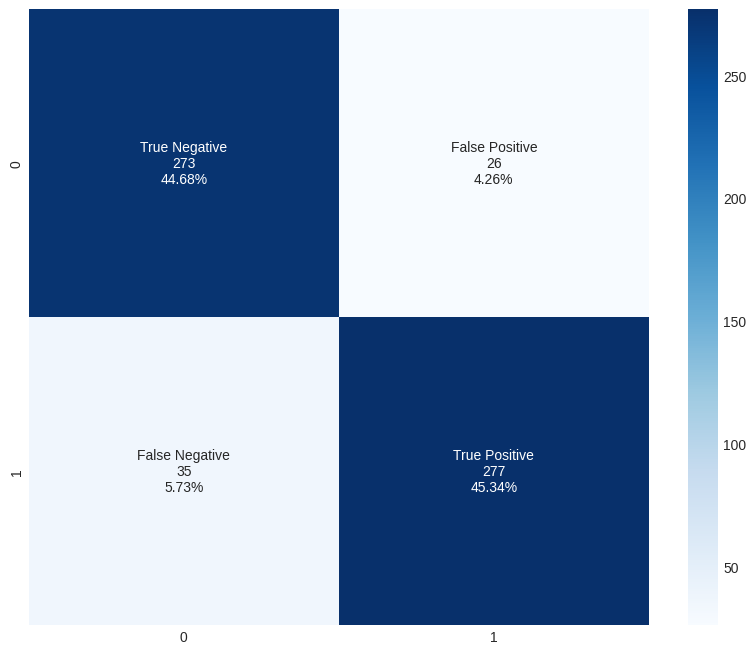

In [ ]:

rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negative", "False Positive", "False Negative", "True Positive"]
group_counts = ["{0:0.0f}".format(value) for value in cf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

plt.figure(figsize=(10, 8))
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues')

In [ ]:

import xgboost as xgb
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, fbeta_score
import numpy as np

# Define your custom scorer with fbeta_score
def custom_fbeta_score(y_true, y_pred):
    return fbeta_score(y_true, y_pred, beta=2, pos_label=0)  # Adjust pos_label as needed

# Create the XGBoost classifier model
xgb_model = xgb.XGBClassifier()

# Define the parameter grid to search
param_grid = {
    'n_estimators': np.arange(50, 200, 25),
    'learning_rate': np.arange(0.01, 0.2, 0.01),
    'max_depth': [3, 4, 5],
    'min_child_weight': [1, 3, 5]
}

# Create a custom scorer
custom_scorer = make_scorer(custom_fbeta_score)

# Create the RandomizedSearchCV object
grid = GridSearchCV(
    estimator=xgb_model,
    param_grid=param_grid,
    scoring=custom_scorer,
    cv=5  # Number of cross-validation folds
)

# Fit the GridSearchCV to your data
grid.fit(X_train, y_train)

# Display the best parameters
print("Best Parameters:")
print(grid.best_params_)

# Display the best score
print("Best Score:", grid.best_score_)

Best Parameters:
{'learning_rate': 0.19, 'max_depth': 4, 'min_child_weight': 1, 'n_estimators': 100}
Best Score: 0.9210525042327429


In [ ]:
best_params = grid.best_params_
xgb = XGBClassifier(**best_params)
xgb.fit(X_train,y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.19, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=4, max_leaves=None,
              min_child_weight=1, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [ ]:
y_train_pred = xgb.predict(X_train)
y_test_pred = xgb.predict(X_test)

print('TRAINING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_train, y_train_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_train, y_train_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_train, y_train_pred))

print('\n======================================================')

print('\nTESTING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_test, y_test_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_test, y_test_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_test, y_test_pred))

TRAINING RESULT:
F2 Score: 0.996
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       0.99      1.00      0.99       719
           1       1.00      0.99      0.99       706

    accuracy                           0.99      1425
   macro avg       0.99      0.99      0.99      1425
weighted avg       0.99      0.99      0.99      1425

Confussion Matrix ------------------------------------
[[717   2]
 [  8 698]]


TESTING RESULT:
F2 Score: 0.898
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       0.89      0.90      0.90       299
           1       0.90      0.90      0.90       312

    accuracy                           0.90       611
   macro avg       0.90      0.90      0.90       611
weighted avg       0.90      0.90      0.90       611

Confussion Matrix ------------------------------------
[[269  30]
 [ 32 280]]


<Axes: >

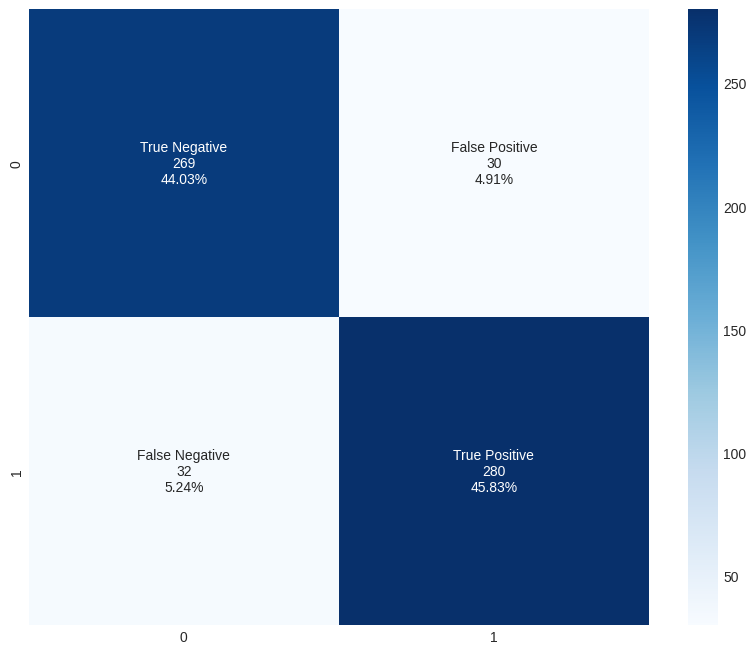

In [ ]:

xgb.fit(X_train, y_train)
y_pred = xgb.predict(X_test)
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negative", "False Positive", "False Negative", "True Positive"]
group_counts = ["{0:0.0f}".format(value) for value in cf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

plt.figure(figsize=(10, 8))
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues')

In [ ]:

import lightgbm as lgb
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, fbeta_score
import numpy as np

# Define your custom scorer with fbeta_score
def custom_fbeta_score(y_true, y_pred):
    return fbeta_score(y_true, y_pred, beta=2, pos_label=0)  # Adjust pos_label as needed

# Create the LightGBM classifier model
lgb_model = lgb.LGBMClassifier()

# Define the parameter grid to search
param_grid = {
    'learning_rate': [0.1, 0.05, 0.01],
    'max_depth': [3, 5, 7],
    'num_leaves': [15, 31, 63],
    'n_estimators': np.arange(50, 200, 50)
}

# Create a custom scorer
custom_scorer = make_scorer(custom_fbeta_score)

# Create the GridSearchCV object
grid = GridSearchCV(
    estimator=lgb_model,
    param_grid=param_grid,  # Add this line to specify the parameter grid
    scoring=custom_scorer,
    cv=5  # Number of cross-validation folds
)

# Fit the GridSearchCV to your data
grid.fit(X_train, y_train)

# Display the best parameters
print("Best Parameters:")
print(grid.best_params_)

# Display the best score
print("Best Score:", grid.best_score_)

Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

In [ ]:
best_params = grid.best_params_
lgbm = LGBMClassifier(**best_params)
lgbm.fit(X_train,y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 706, number of negative: 719
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000271 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2100
[LightGBM] [Info] Number of data points in the train set: 1425, number of used features: 25
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495439 -> initscore=-0.018246
[LightGBM] [Info] Start training from score -0.018246
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

LGBMClassifier(max_depth=7, num_leaves=63)

In [ ]:
y_train_pred = lgbm.predict(X_train)
y_test_pred = lgbm.predict(X_test)

print('TRAINING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_train, y_train_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_train, y_train_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_train, y_train_pred))

print('\n======================================================')

print('\nTESTING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_test, y_test_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_test, y_test_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_test, y_test_pred))

TRAINING RESULT:
F2 Score: 1.0
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       719
           1       1.00      1.00      1.00       706

    accuracy                           1.00      1425
   macro avg       1.00      1.00      1.00      1425
weighted avg       1.00      1.00      1.00      1425

Confussion Matrix ------------------------------------
[[719   0]
 [  0 706]]


TESTING RESULT:
F2 Score: 0.912
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       0.91      0.91      0.91       299
           1       0.92      0.91      0.91       312

    accuracy                           0.91       611
   macro avg       0.91      0.91      0.91       611
weighted avg       0.91      0.91      0.91       611

Confussion Matrix ------------------------------------
[[273  26]
 [ 27 285]]


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 706, number of negative: 719
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000211 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2100
[LightGBM] [Info] Number of data points in the train set: 1425, number of used features: 25
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495439 -> initscore=-0.018246
[LightGBM] [Info] Start training from score -0.018246
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

<Axes: >

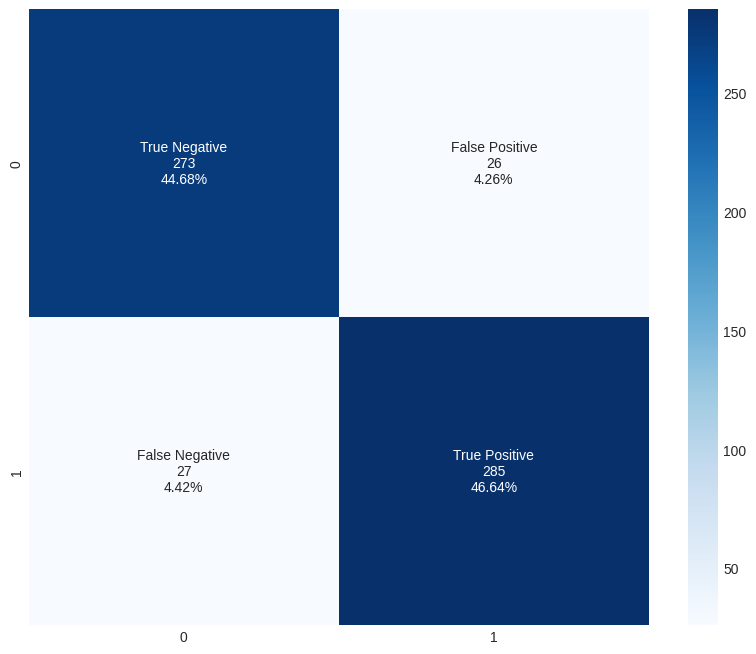

In [ ]:

lgbm.fit(X_train, y_train)
y_pred = lgbm.predict(X_test)
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negative", "False Positive", "False Negative", "True Positive"]
group_counts = ["{0:0.0f}".format(value) for value in cf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

plt.figure(figsize=(10, 8))
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues')

In [ ]:
# KNN
paramk = {
    'n_neighbors': [3, 5, 7],
    'weights': ['uniform', 'distance'],
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
    'leaf_size': [10, 20, 30],
    'p': [1, 2]
}

In [ ]:

f2_scorer = make_scorer(fbeta_score, pos_label=0, beta=2)
g = GridSearchCV(KNeighborsClassifier(), paramk, cv=5, scoring=f2_scorer)
g.fit(X_train,y_train)

GridSearchCV(cv=5, estimator=KNeighborsClassifier(),
             param_grid={'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
                         'leaf_size': [10, 20, 30], 'n_neighbors': [3, 5, 7],
                         'p': [1, 2], 'weights': ['uniform', 'distance']},
             scoring=make_scorer(fbeta_score, pos_label=0, beta=2))

In [ ]:
print(g.best_params_)

{'algorithm': 'auto', 'leaf_size': 10, 'n_neighbors': 3, 'p': 1, 'weights': 'distance'}


In [ ]:
best_params = g.best_params_
knn = KNeighborsClassifier(**best_params)
knn.fit(X_train,y_train)

KNeighborsClassifier(leaf_size=10, n_neighbors=3, p=1, weights='distance')

In [ ]:
y_train_pred = knn.predict(X_train)
y_test_pred = knn.predict(X_test)

print('TRAINING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_train, y_train_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_train, y_train_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_train, y_train_pred))

print('\n======================================================')

print('\nTESTING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_test, y_test_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_test, y_test_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_test, y_test_pred))

TRAINING RESULT:
F2 Score: 1.0
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       719
           1       1.00      1.00      1.00       706

    accuracy                           1.00      1425
   macro avg       1.00      1.00      1.00      1425
weighted avg       1.00      1.00      1.00      1425

Confussion Matrix ------------------------------------
[[719   0]
 [  0 706]]


TESTING RESULT:
F2 Score: 0.802
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       0.95      0.77      0.85       299
           1       0.81      0.96      0.88       312

    accuracy                           0.87       611
   macro avg       0.88      0.87      0.87       611
weighted avg       0.88      0.87      0.87       611

Confussion Matrix ------------------------------------
[[231  68]
 [ 13 299]]


<Axes: >

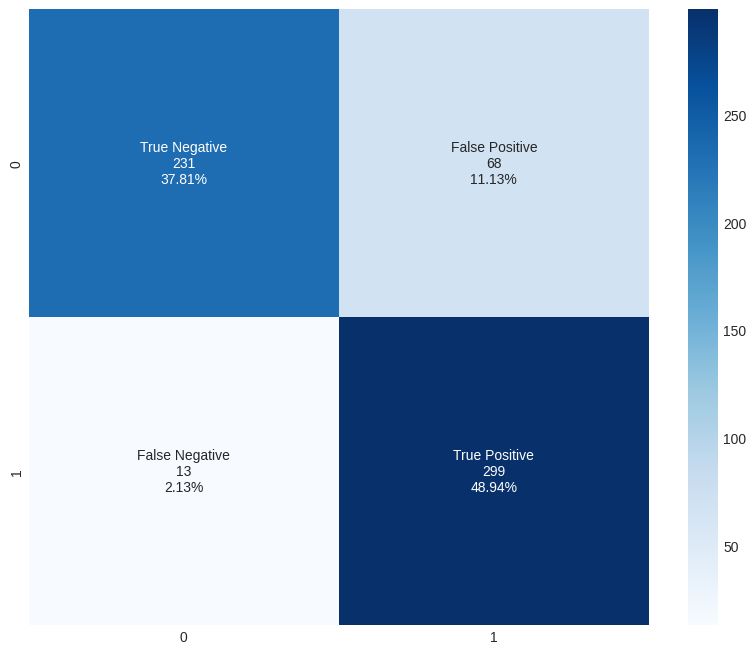

In [ ]:

knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negative", "False Positive", "False Negative", "True Positive"]
group_counts = ["{0:0.0f}".format(value) for value in cf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

plt.figure(figsize=(10, 8))
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues')

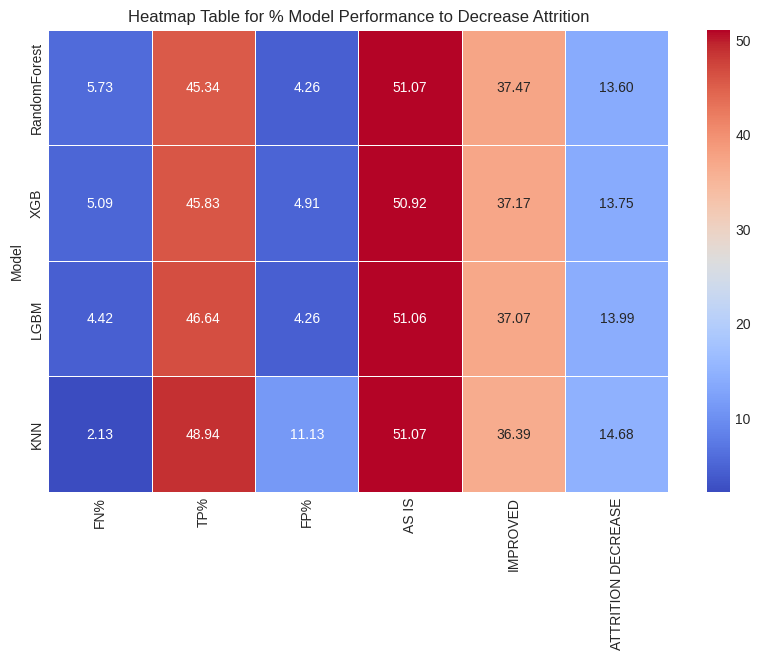

In [ ]:

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Data masing-masing model (remove the % sign and convert to float)
fn_rf  = 5.73
tp_rf  = 45.34
fp_rf  = 4.26
fn_xgb = 5.09
tp_xgb = 45.83
fp_xgb = 4.91
fn_lgbm= 4.42
tp_lgbm= 46.64
fp_lgbm= 4.26
fn_knn = 2.13
tp_knn = 48.94
fp_knn = 11.13

# Data FN%, TP%, FP% dari masing-masing model
data = {
    'Model': ['RandomForest', 'XGB', 'LGBM', 'KNN'],
    'FN%': [fn_rf, fn_xgb, fn_lgbm, fn_knn],
    'TP%': [tp_rf, tp_xgb, tp_lgbm, tp_knn],
    'FP%': [fp_rf, fp_xgb, fp_lgbm, fp_knn]
}

dfx = pd.DataFrame(data)

# Rumus untuk menghitung AS IS, IMPROVED, dan MODEL PERFORMANCE
eff_rate = 0.3

dfx['AS IS'] = dfx['FN%'] + dfx['TP%']
dfx['IMPROVED'] = dfx['FN%'] + ((1 - eff_rate) * dfx['TP%'])
dfx['ATTRITION DECREASE'] = (dfx['AS IS'] - dfx['IMPROVED'])

# Membuat heatmap
heatmap_data = dfx[['Model', 'FN%', 'TP%', 'FP%', 'AS IS', 'IMPROVED', 'ATTRITION DECREASE']]
heatmap_data = heatmap_data.set_index('Model')
plt.figure(figsize=(10, 6))
sns.heatmap(heatmap_data, annot=True, fmt=".2f", cmap="coolwarm", linewidths=0.5)
plt.title("Heatmap Table for % Model Performance to Decrease Attrition")
plt.show()

Berdasarkan hasil perbandingan model di atas, pada dasarnya ke empat model telah melampaui target penurunan Attrition Rate 12%. Sehingga memilih target manapun is okay. Namun, model memiliki karakteristik faktor pendukung yang berbeda. Rasio FN (False Negative) dan FP (False Positive) yang berbeda-beda.

Sehingga, dalam menentukan model yang dipilih, kami membuat beberapa kriteria tertentu:

**1. Memiliki Attrition Decrease ≥12%(target)**

**2. FN% lebih rendah dari Mean FN% semua model (4.34%)**

**3. FP% lebih rendah dari Mean FP% semua model (6.14%)**

Maka, model yang terpilih adalah **LGBMClassififier.**

**Walaupun KNN memiliki TP tertinggi dan FN terendah tidak dipilih** karena, FP% 11.13% yang > Mean FP%. Hal ini artinya akan ada lebih banyak karyawan yang tidak seharusnya diberi perlakuan/treatment namun tetap diberlakukan sehingga cost company terpakai secara tidak efektif dibanding model lain.

# Model Interpretation with SHAP method

In [ ]:
pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.9/547.9 kB 5.7 MB/s eta 0:00:00


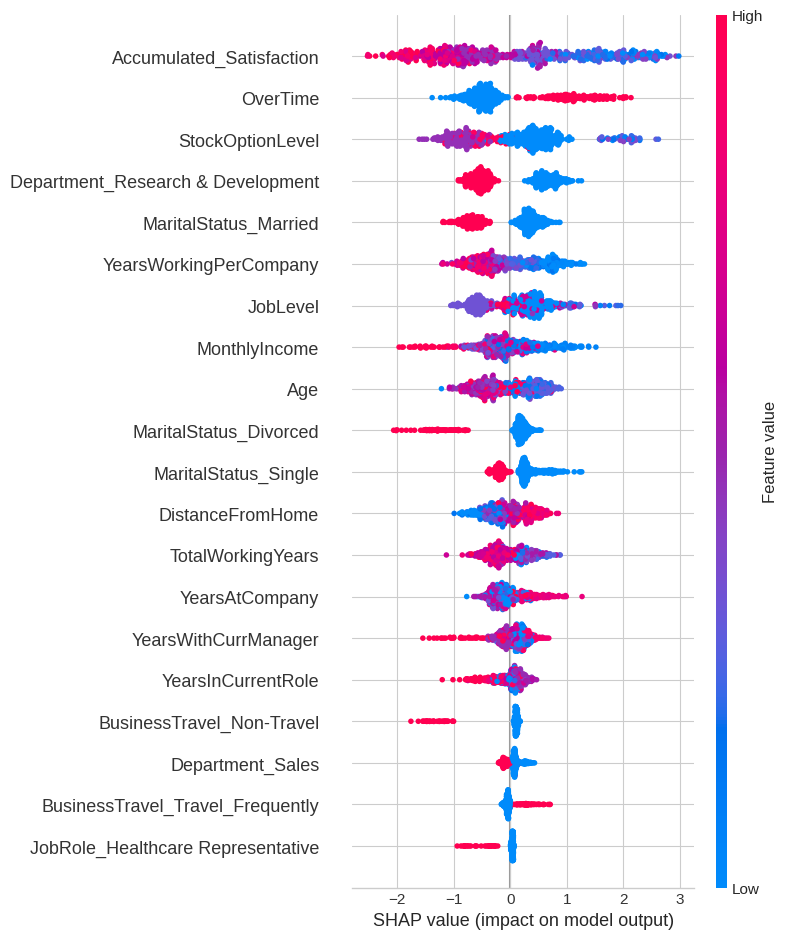

In [ ]:
import shap
explainer = shap.TreeExplainer(lgbm)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values[1], X_test)

In [ ]:
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][0:1], X_test.iloc[0,:])

Selanjutnya akan evaluasi model dengan 5 feature importance dan 9 feature importance.

## Hyperparameter Tuning dengan 5 Feature Importance

#### Before Hyperparameter 5 features

In [ ]:
lgbm = LGBMClassifier(random_state=42)
lgbm.fit(X_train[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married']],y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 706, number of negative: 719
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000176 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 311
[LightGBM] [Info] Number of data points in the train set: 1425, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495439 -> initscore=-0.018246
[LightGBM] [Info] Start training from score -0.018246


LGBMClassifier(random_state=42)

In [ ]:
y_train_pred = lgbm.predict(X_train[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married']])
y_test_pred = lgbm.predict(X_test[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married']])

print('TRAINING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_train, y_train_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_train, y_train_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_train, y_train_pred))

print('\n======================================================')

print('\nTESTING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_test, y_test_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_test, y_test_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_test, y_test_pred))

TRAINING RESULT:
F2 Score: 0.911
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       0.88      0.92      0.90       719
           1       0.91      0.87      0.89       706

    accuracy                           0.90      1425
   macro avg       0.90      0.90      0.90      1425
weighted avg       0.90      0.90      0.90      1425

Confussion Matrix ------------------------------------
[[661  58]
 [ 89 617]]


TESTING RESULT:
F2 Score: 0.861
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       0.88      0.86      0.87       299
           1       0.87      0.89      0.88       312

    accuracy                           0.87       611
   macro avg       0.87      0.87      0.87       611
weighted avg       0.87      0.87      0.87       611

Confussion Matrix ------------------------------------
[[256  43]
 [ 35 277]]


<Axes: >

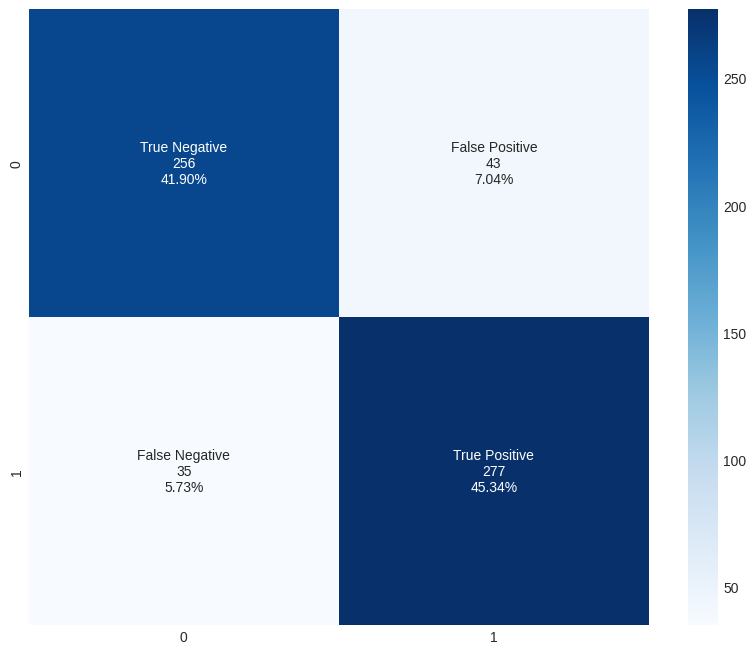

In [ ]:
y_pred = lgbm.predict(X_test[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married']])
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negative", "False Positive", "False Negative", "True Positive"]
group_counts = ["{0:0.0f}".format(value) for value in cf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

plt.figure(figsize=(10, 8))
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues')

### Check Model with Best Parameter

In [ ]:

lgbm = LGBMClassifier(max_depth=7, n_estimators=100, num_leaves=63)
lgbm.fit(X_train[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married']],y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 706, number of negative: 719
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000199 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 311
[LightGBM] [Info] Number of data points in the train set: 1425, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495439 -> initscore=-0.018246
[LightGBM] [Info] Start training from score -0.018246
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

LGBMClassifier(max_depth=7, num_leaves=63)

In [ ]:
y_train_pred = lgbm.predict(X_train[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married']])
y_test_pred = lgbm.predict(X_test[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married']])

print('TRAINING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_train, y_train_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_train, y_train_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_train, y_train_pred))

print('\n======================================================')

print('\nTESTING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_test, y_test_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_test, y_test_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_test, y_test_pred))

TRAINING RESULT:
F2 Score: 0.91
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       0.88      0.92      0.90       719
           1       0.91      0.87      0.89       706

    accuracy                           0.90      1425
   macro avg       0.90      0.90      0.90      1425
weighted avg       0.90      0.90      0.90      1425

Confussion Matrix ------------------------------------
[[660  59]
 [ 90 616]]


TESTING RESULT:
F2 Score: 0.86
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       0.87      0.86      0.86       299
           1       0.86      0.88      0.87       312

    accuracy                           0.87       611
   macro avg       0.87      0.87      0.87       611
weighted avg       0.87      0.87      0.87       611

Confussion Matrix ------------------------------------
[[256  43]
 [ 37 275]]


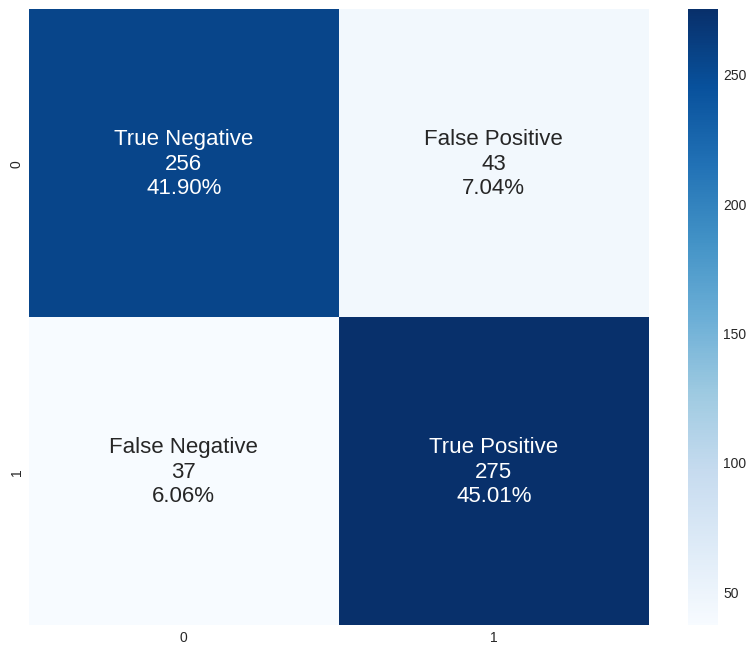

In [ ]:
y_pred = lgbm.predict(X_test[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married']])
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negative", "False Positive", "False Negative", "True Positive"]
group_counts = ["{0:0.0f}".format(value) for value in cf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

plt.figure(figsize=(10, 8))
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues', annot_kws={"fontsize":16})
plt.savefig('cm', dpi=500)

# Coba TOP 9 features

In [ ]:

lgbm = LGBMClassifier(random_state = 42)
lgbm.fit(X_train[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married', 'YearsWorkingPerCompany', 'JobLevel', 'MonthlyIncome', 'Age']],y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 706, number of negative: 719
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000168 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1122
[LightGBM] [Info] Number of data points in the train set: 1425, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495439 -> initscore=-0.018246
[LightGBM] [Info] Start training from score -0.018246


LGBMClassifier(random_state=42)

In [ ]:
y_train_pred = lgbm.predict(X_train[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married', 'YearsWorkingPerCompany', 'JobLevel', 'MonthlyIncome', 'Age']])
y_test_pred = lgbm.predict(X_test[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married', 'YearsWorkingPerCompany', 'JobLevel', 'MonthlyIncome', 'Age']])

print('TRAINING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_train, y_train_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_train, y_train_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_train, y_train_pred))

print('\n======================================================')

print('\nTESTING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_test, y_test_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_test, y_test_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_test, y_test_pred))

TRAINING RESULT:
F2 Score: 0.999
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       719
           1       1.00      1.00      1.00       706

    accuracy                           1.00      1425
   macro avg       1.00      1.00      1.00      1425
weighted avg       1.00      1.00      1.00      1425

Confussion Matrix ------------------------------------
[[718   1]
 [  0 706]]


TESTING RESULT:
F2 Score: 0.899
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       0.91      0.90      0.90       299
           1       0.90      0.91      0.91       312

    accuracy                           0.91       611
   macro avg       0.91      0.90      0.91       611
weighted avg       0.91      0.91      0.91       611

Confussion Matrix ------------------------------------
[[268  31]
 [ 27 285]]


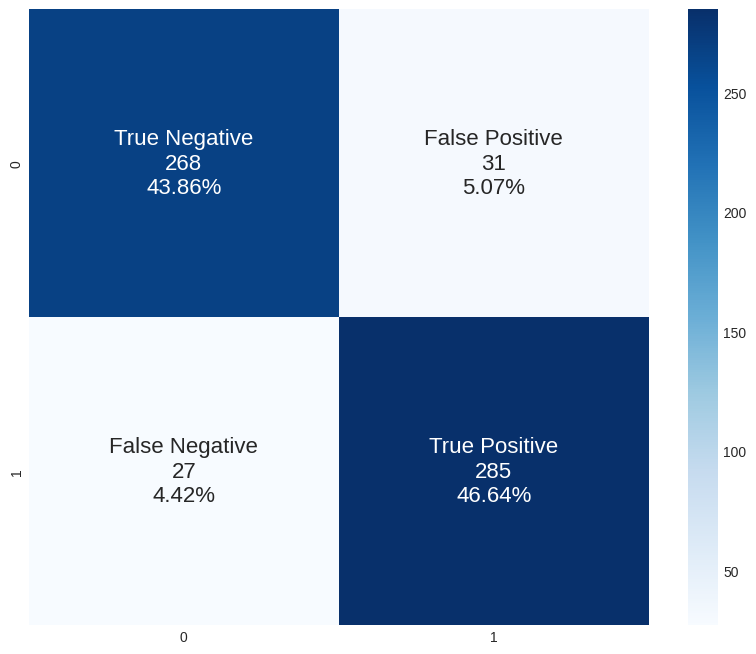

In [ ]:
y_pred = lgbm.predict(X_test[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married', 'YearsWorkingPerCompany', 'JobLevel', 'MonthlyIncome', 'Age']])
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negative", "False Positive", "False Negative", "True Positive"]
group_counts = ["{0:0.0f}".format(value) for value in cf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

plt.figure(figsize=(10, 8))
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues', annot_kws={"fontsize":16})
plt.savefig('cm', dpi=500)

#### Use Best Parameter

In [ ]:

lgbm = LGBMClassifier(max_depth=7, n_estimators=150, num_leaves=15)
lgbm.fit(X_train[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married', 'YearsWorkingPerCompany', 'JobLevel', 'MonthlyIncome', 'Age']],y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 706, number of negative: 719
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000196 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1122
[LightGBM] [Info] Number of data points in the train set: 1425, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495439 -> initscore=-0.018246
[LightGBM] [Info] Start training from score -0.018246
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


LGBMClassifier(max_depth=7, n_estimators=150, num_leaves=15)

In [ ]:
y_train_pred = lgbm.predict(X_train[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married', 'YearsWorkingPerCompany', 'JobLevel', 'MonthlyIncome', 'Age']])
y_test_pred = lgbm.predict(X_test[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married', 'YearsWorkingPerCompany', 'JobLevel', 'MonthlyIncome', 'Age']])

print('TRAINING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_train, y_train_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_train, y_train_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_train, y_train_pred))

print('\n======================================================')

print('\nTESTING RESULT:')
print('======================================================')
print('F2 Score:', np.round(fbeta_score(y_test, y_test_pred, pos_label=0, beta=2),3))
print('======================================================')
print('Classification Report --------------------------------')
print(classification_report(y_test, y_test_pred))
print('======================================================')
print('Confussion Matrix ------------------------------------')
print(confusion_matrix(y_test, y_test_pred))

TRAINING RESULT:
F2 Score: 0.994
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       0.99      1.00      0.99       719
           1       1.00      0.99      0.99       706

    accuracy                           0.99      1425
   macro avg       0.99      0.99      0.99      1425
weighted avg       0.99      0.99      0.99      1425

Confussion Matrix ------------------------------------
[[716   3]
 [  9 697]]


TESTING RESULT:
F2 Score: 0.91
Classification Report --------------------------------
              precision    recall  f1-score   support

           0       0.91      0.91      0.91       299
           1       0.91      0.92      0.92       312

    accuracy                           0.91       611
   macro avg       0.91      0.91      0.91       611
weighted avg       0.91      0.91      0.91       611

Confussion Matrix ------------------------------------
[[272  27]
 [ 26 286]]


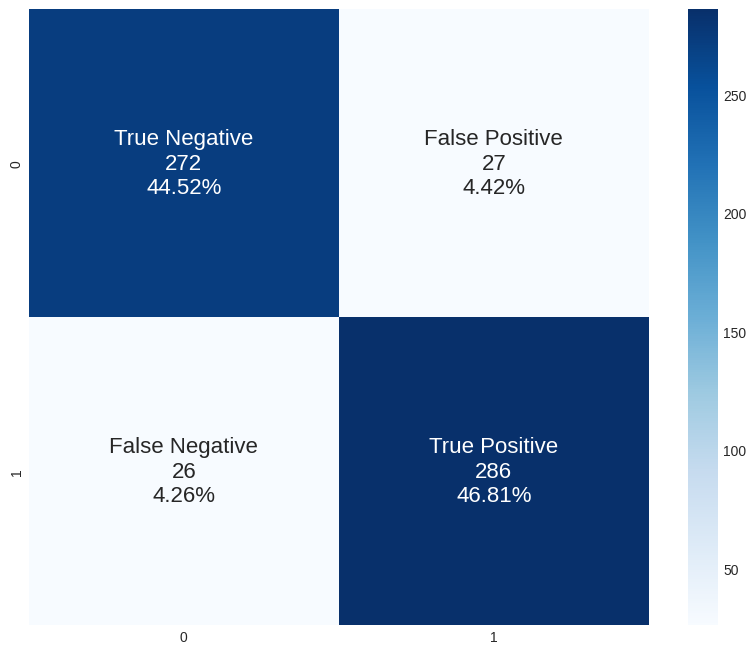

In [ ]:
y_pred = lgbm.predict(X_test[['Accumulated_Satisfaction', 'OverTime', 'StockOptionLevel', 'Department_Research & Development', 'MaritalStatus_Married', 'YearsWorkingPerCompany', 'JobLevel', 'MonthlyIncome', 'Age']])
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negative", "False Positive", "False Negative", "True Positive"]
group_counts = ["{0:0.0f}".format(value) for value in cf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

plt.figure(figsize=(10, 8))
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues', annot_kws={"fontsize":16})
plt.savefig('cm', dpi=500)

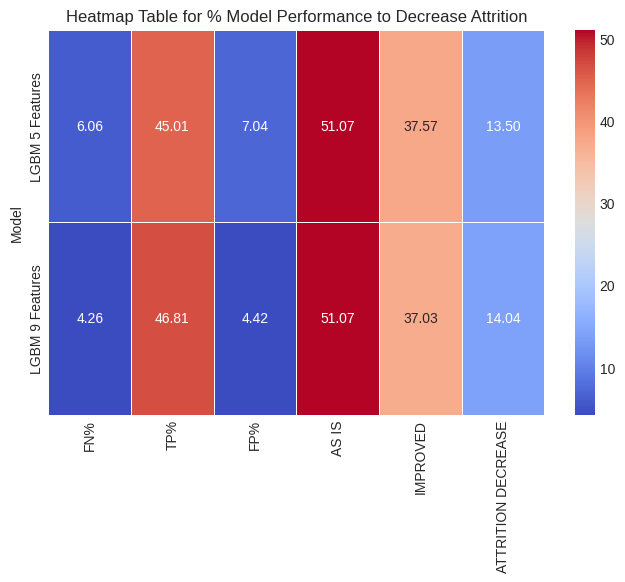

In [ ]:

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Data masing-masing model (remove the % sign and convert to float)
fn_lgbm5= 6.06
tp_lgbm5= 45.01
fp_lgbm5= 7.04
fn_lgbm9= 4.26
tp_lgbm9= 46.81
fp_lgbm9= 4.42

# Data FN%, TP%, FP% dari masing-masing model
data = {
    'Model': ['LGBM 5 Features', 'LGBM 9 Features'],
    'FN%': [fn_lgbm5, fn_lgbm9],
    'TP%': [tp_lgbm5, tp_lgbm9],
    'FP%': [fp_lgbm5, fp_lgbm9]
}

dfc = pd.DataFrame(data)

# Rumus untuk menghitung AS IS, IMPROVED, dan MODEL PERFORMANCE
eff_rate = 0.3

dfc['AS IS'] = dfc['FN%'] + dfc['TP%']
dfc['IMPROVED'] = dfc['FN%'] + ((1 - eff_rate) * dfc['TP%'])
dfc['ATTRITION DECREASE'] = (dfc['AS IS'] - dfc['IMPROVED'])

# Membuat heatmap
heatmap_data = dfc[['Model', 'FN%', 'TP%', 'FP%', 'AS IS', 'IMPROVED', 'ATTRITION DECREASE']]
heatmap_data = heatmap_data.set_index('Model')
plt.figure(figsize=(8, 5))
sns.heatmap(heatmap_data, annot=True, fmt=".2f", cmap="coolwarm", linewidths=0.5)
plt.title("Heatmap Table for % Model Performance to Decrease Attrition")
plt.show()

Berdasarkan performa model di atas kami memutuskan untuk memilih model dengan Top 9 features importance karena:
1. Memiliki FN% terendah, lebih rendah dari model dengan All Features Importance
2. Memiliki Attrition Decrease tertinggi dan, lebih tinggi dari nilai model with All Features Importance
3. Memiliki FP% terendah dibandingkan Top 5 model, dan tidak teroaut jauh dari model All Features.
4. Good fit.

## Business Recommendation Impact Solution

#### Intervention to Increase MonthlyIncome or Salary to Decrease Attrition/Increase Employee Retention

In [7]:

import pandas as pd

# Path ke file CSV di Google Drive Anda
file_path = '/content/drive/My Drive/Stage 3/Dataset FinPro.csv'

# Membaca dataset CSV
dft = pd.read_csv(file_path)

In [8]:
dft['Attrition'] = dft['Attrition'].apply(lambda x:1 if x == "Yes" else 0 )
dft['OverTime'] = dft['OverTime'].apply(lambda x:1 if x == "Yes" else 0 )

In [ ]:
simulation_feature = ['MonthlyIncome']

#### Use LGBM with its best param

In [ ]:
lgbmt = LGBMClassifier(max_depth=7, n_estimators=100, num_leaves=63)
lgbmt.fit(X_train[['MonthlyIncome']], y_train)

[LightGBM] [Info] Number of positive: 706, number of negative: 719
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 255
[LightGBM] [Info] Number of data points in the train set: 1425, number of used features: 1
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495439 -> initscore=-0.018246
[LightGBM] [Info] Start training from score -0.018246
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

LGBMClassifier(max_depth=7, num_leaves=63)

[0.08775510204081632, 0.13197278911564625, 0.43605442176870746, 0.35034013605442177, 0.2857142857142857, 0.31768707482993197, 0.2755102040816326, 0.308843537414966, 0.2748299319727891, 0.2829931972789116, 0.2646258503401361, 0.2707482993197279, 0.29183673469387755, 0.282312925170068, 0.3074829931972789, 0.3489795918367347, 0.40068027210884355, 0.45034013605442175, 0.4306122448979592, 0.4122448979591837, 0.42585034013605444, 0.44693877551020406, 0.46122448979591835, 0.45374149659863944, 0.47006802721088436, 0.46258503401360546, 0.47959183673469385, 0.4959183673469388, 0.5238095238095238, 0.5142857142857142, 0.5, 0.48299319727891155, 0.45918367346938777, 0.45850340136054424, 0.46530612244897956, 0.4891156462585034, 0.4925170068027211, 0.49523809523809526, 0.5149659863945578, 0.5319727891156463]


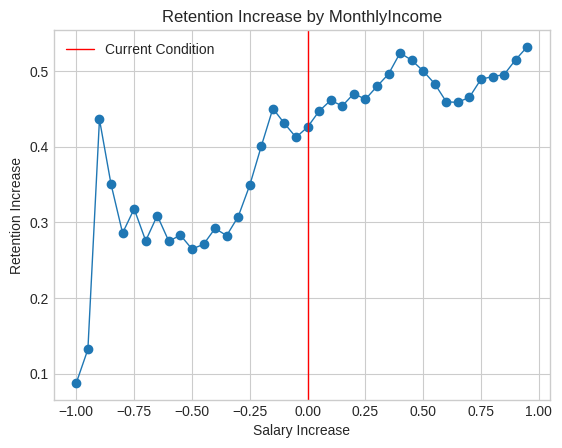

In [ ]:
from sklearn.preprocessing import StandardScaler

# Define TP FN FP TN var
tp, fn, fp, tn = cf_matrix.flatten()

# Create Simulation Data
df_attrition = dft[dft.Attrition == 1][simulation_feature]
df_not_attrition = dft[dft.Attrition == 0][simulation_feature]

cr_list = []

# Create Improvement Experiments
experiments = np.arange(-1, 1, 0.05)
experiments[20] = 0

# Create a DataFrame with all features, including 'MonthlyIncome'
df_simulation = dft.copy()

for feature in simulation_feature:
    scaler = StandardScaler()
    df_simulation[feature] = scaler.fit_transform(df_simulation[[feature]])  # Fit and transform 'MonthlyIncome'

for i in experiments:
    df_simulation_copy = df_simulation.copy()
    df_simulation_copy['MonthlyIncome'] = df_simulation_copy['MonthlyIncome'] * (1 + i)

    # Predict Simulation Values
    # Reshape the input data to have a 2D shape with one column
    simulation_pred = lgbmt.predict(df_simulation_copy['MonthlyIncome'].values.reshape(-1, 1))

    # Adjust Predicted Value to Actual Value
    simulation_pred_pos = simulation_pred[simulation_pred == 0]
    simulation_pred_pos[:(int(np.ceil((fp / (fp + tp)) * (simulation_pred[simulation_pred == 0].size))))] = 1
    simulation_pred_neg = simulation_pred[simulation_pred == 1]
    simulation_pred_neg[:(int(np.ceil((fn / (fn + tn)) * (simulation_pred[simulation_pred == 1].size))))] = 0
    simulation_pred = np.concatenate((simulation_pred_neg, simulation_pred_pos))

    # Calculate Simulation
    cr = simulation_pred[simulation_pred == 1].size / simulation_pred.size
    cr_list.append(cr)

# Create CR Plot
print(cr_list)
plt.plot(experiments, cr_list, marker='o', linewidth=1)
plt.ylabel('Retention Increase')
plt.xlabel('Salary Increase')
plt.title('Retention Increase by MonthlyIncome')
plt.axvline(linewidth=1, color='r', label='Current Condition')
plt.legend()
plt.show()

We will choose the point of improvement to increase 10% of Employee's Salary in general

In [ ]:
# Now, let's test a 10% increase in MonthlyIncome
df_simulation_10percent = df_simulation.copy()
df_simulation_10percent['MonthlyIncome'] = df_simulation_10percent['MonthlyIncome'] * 1.10  # Increase MonthlyIncome by 12%

# Predict Simulation Values
# Reshape the input data to have a 2D shape with one column
simulation_pred_10percent = lgbmt.predict(df_simulation_10percent['MonthlyIncome'].values.reshape(-1, 1))

# Adjust Predicted Value to Actual Value
simulation_pred_pos_10percent = simulation_pred_10percent[simulation_pred_10percent == 0]
simulation_pred_pos_10percent[:(int(np.ceil((fp / (fp + tp)) * (simulation_pred_10percent[simulation_pred_10percent == 0].size))))] = 1
simulation_pred_neg_10percent = simulation_pred_10percent[simulation_pred_10percent == 1]
simulation_pred_neg_10percent[:(int(np.ceil((fn / (fn + tn)) * (simulation_pred_10percent[simulation_pred_10percent == 1].size))))] = 0
simulation_pred_10percent = np.concatenate((simulation_pred_neg_10percent, simulation_pred_pos_10percent))

# Calculate Simulation Attrition Rate
new_attrition_rate_10percent = simulation_pred_10percent[simulation_pred_10percent == 1].size / simulation_pred_10percent.size

print(f'Simulation of Decreasing Attrition Rate After 10% MonthlyIncome Increase = {new_attrition_rate_10percent * 100:.2f}% From Initial Attrition')

Simulation of Decreasing Attrition Rate After 10% MonthlyIncome Increase = 46.12% From Initial Attrition


Berdasarkan hasil simulasi di atas, diketahui bahwa jika perusahaan melakukan **kenaikan gaji sebesar 10%** untuk **semua karyawan yang diprediksi Attrition**, maka dampaknya akan menurunkan sebesar 46.12% jumlah karyawan attrition. Atau jika dikonversi akan menurunkan Attrition dari **109 karyawan.**

In [ ]:

from sklearn.preprocessing import StandardScaler

# Define TP FN FP TN var
tp, fn, fp, tn = cf_matrix.flatten()

# Create Simulation Data
df_attrition = dft[dft.Attrition == 1][simulation_feature]
df_not_attrition = dft[dft.Attrition == 0][simulation_feature]

# Create Improvement Experiments
experiments = np.arange(-1, 1, 0.05)
experiments[20] = 0

# Create a DataFrame with all features, including 'MonthlyIncome'
df_simulation = dft.copy()

for feature in simulation_feature:
    scaler = StandardScaler()
    df_simulation[feature] = scaler.fit_transform(df_simulation[[feature]])  # Fit and transform 'MonthlyIncome'

# Group MonthlyIncome into "Low," "Mid," and "High" categories based on quantiles
low_income = df_simulation[df_simulation['MonthlyIncome'] <= df_simulation['MonthlyIncome'].quantile(1/3)]
mid_income = df_simulation[(df_simulation['MonthlyIncome'] > df_simulation['MonthlyIncome'].quantile(1/3)) & (df_simulation['MonthlyIncome'] <= df_simulation['MonthlyIncome'].quantile(2/3))]
high_income = df_simulation[df_simulation['MonthlyIncome'] > df_simulation['MonthlyIncome'].quantile(2/3)]

# Initialize lists to store results for each income category
cr_list_low = []
cr_list_mid = []
cr_list_high = []

# Perform simulations for each income category
for i in experiments:
    # For "Low" income category
    df_simulation_low = low_income.copy()
    df_simulation_low['MonthlyIncome'] = df_simulation_low['MonthlyIncome'] * (1 + i)

    # Predict Simulation Values for "Low" income category
    simulation_pred_low = lgbmt.predict(df_simulation_low['MonthlyIncome'].values.reshape(-1, 1))

    # Adjust Predicted Value to Actual Value for "Low" income category
    simulation_pred_pos_low = simulation_pred_low[simulation_pred_low == 0]
    simulation_pred_pos_low[:(int(np.ceil((fp / (fp + tp)) * (simulation_pred_low[simulation_pred_low == 0].size))))] = 1
    simulation_pred_neg_low = simulation_pred_low[simulation_pred_low == 1]
    simulation_pred_neg_low[:(int(np.ceil((fn / (fn + tn)) * (simulation_pred_low[simulation_pred_low == 1].size))))] = 0
    simulation_pred_low = np.concatenate((simulation_pred_neg_low, simulation_pred_pos_low))

    # Calculate Simulation for "Low" income category
    cr_low = simulation_pred_low[simulation_pred_low == 1].size / simulation_pred_low.size
    cr_list_low.append(cr_low)

    # Repeat the same process for "Mid" income category
    df_simulation_mid = mid_income.copy()
    df_simulation_mid['MonthlyIncome'] = df_simulation_mid['MonthlyIncome'] * (1 + i)
    simulation_pred_mid = lgbmt.predict(df_simulation_mid['MonthlyIncome'].values.reshape(-1, 1))
    simulation_pred_pos_mid = simulation_pred_mid[simulation_pred_mid == 0]
    simulation_pred_pos_mid[:(int(np.ceil((fp / (fp + tp)) * (simulation_pred_mid[simulation_pred_mid == 0].size))))] = 1
    simulation_pred_neg_mid = simulation_pred_mid[simulation_pred_mid == 1]
    simulation_pred_neg_mid[:(int(np.ceil((fn / (fn + tn)) * (simulation_pred_mid[simulation_pred_mid == 1].size))))] = 0
    simulation_pred_mid = np.concatenate((simulation_pred_neg_mid, simulation_pred_pos_mid))
    cr_mid = simulation_pred_mid[simulation_pred_mid == 1].size / simulation_pred_mid.size
    cr_list_mid.append(cr_mid)

    # Repeat the same process for "High" income category
    df_simulation_high = high_income.copy()
    df_simulation_high['MonthlyIncome'] = df_simulation_high['MonthlyIncome'] * (1 + i)
    simulation_pred_high = lgbmt.predict(df_simulation_high['MonthlyIncome'].values.reshape(-1, 1))
    simulation_pred_pos_high = simulation_pred_high[simulation_pred_high == 0]
    simulation_pred_pos_high[:(int(np.ceil((fp / (fp + tp)) * (simulation_pred_high[simulation_pred_high == 0].size))))] = 1
    simulation_pred_neg_high = simulation_pred_high[simulation_pred_high == 1]
    simulation_pred_neg_high[:(int(np.ceil((fn / (fn + tn)) * (simulation_pred_high[simulation_pred_high == 1].size))))] = 0
    simulation_pred_high = np.concatenate((simulation_pred_neg_high, simulation_pred_pos_high))
    cr_high = simulation_pred_high[simulation_pred_high == 1].size / simulation_pred_high.size
    cr_list_high.append(cr_high)

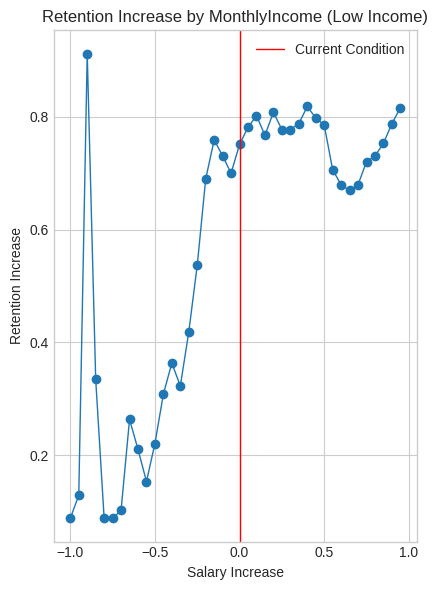

[0.08775510204081632, 0.12857142857142856, 0.9122448979591836, 0.3346938775510204, 0.08775510204081632, 0.08775510204081632, 0.10204081632653061, 0.26326530612244897, 0.21020408163265306, 0.15306122448979592, 0.22040816326530613, 0.3081632653061224, 0.363265306122449, 0.3224489795918367, 0.41836734693877553, 0.536734693877551, 0.689795918367347, 0.7591836734693878, 0.7306122448979592, 0.7, 0.7510204081632653, 0.7816326530612245, 0.8020408163265306, 0.7673469387755102, 0.8081632653061225, 0.7775510204081633, 0.7775510204081633, 0.7877551020408163, 0.8183673469387756, 0.7979591836734694, 0.7857142857142857, 0.7061224489795919, 0.6795918367346939, 0.6693877551020408, 0.6795918367346939, 0.7204081632653061, 0.7306122448979592, 0.753061224489796, 0.7877551020408163, 0.8163265306122449]


In [ ]:
# Create CR Plots for each income category
plt.figure(figsize=(12, 6))
plt.subplot(131)
plt.plot(experiments, cr_list_low, marker='o', linewidth=1)
plt.ylabel('Retention Increase')
plt.xlabel('Salary Increase')
plt.title('Retention Increase by MonthlyIncome (Low Income)')
plt.axvline(linewidth=1, color='r', label='Current Condition')
plt.legend()
plt.tight_layout()
plt.show()
print(cr_list_low)

Kami memilih point of improvement kenaikan salary kelompok MonthlyIncome Low sebesar 10%. Action ini dapat menurunkan Attrition sebesar 5%.

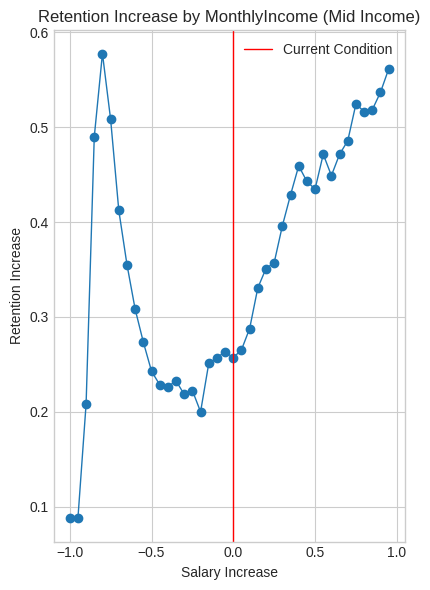

[0.08775510204081632, 0.08775510204081632, 0.20816326530612245, 0.4897959183673469, 0.5775510204081633, 0.5081632653061224, 0.4122448979591837, 0.3551020408163265, 0.3081632653061224, 0.27346938775510204, 0.24285714285714285, 0.22857142857142856, 0.22653061224489796, 0.23265306122448978, 0.21836734693877552, 0.22244897959183674, 0.2, 0.2510204081632653, 0.2571428571428571, 0.26326530612244897, 0.2571428571428571, 0.2653061224489796, 0.28775510204081634, 0.3306122448979592, 0.3510204081632653, 0.35714285714285715, 0.39591836734693875, 0.42857142857142855, 0.45918367346938777, 0.44285714285714284, 0.4346938775510204, 0.4714285714285714, 0.4489795918367347, 0.4714285714285714, 0.4857142857142857, 0.5244897959183673, 0.5163265306122449, 0.5183673469387755, 0.536734693877551, 0.5612244897959183]


In [ ]:

plt.figure(figsize=(12, 6))
plt.subplot(132)
plt.plot(experiments, cr_list_mid, marker='o', linewidth=1)
plt.ylabel('Retention Increase')
plt.xlabel('Salary Increase')
plt.title('Retention Increase by MonthlyIncome (Mid Income)')
plt.axvline(linewidth=1, color='r', label='Current Condition')
plt.legend()
plt.tight_layout()
plt.show()
print(cr_list_mid)

Kami memilih point of improvement kenaikan salary kelompok MonthlyIncome Mid sebesar 15%. Action ini dapat menurunkan Attrition sebesar 7.3%.

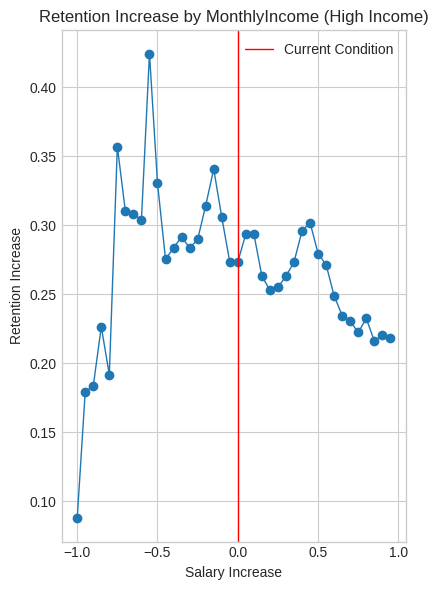

[0.08775510204081632, 0.17959183673469387, 0.1836734693877551, 0.22653061224489796, 0.19183673469387755, 0.35714285714285715, 0.31020408163265306, 0.3081632653061224, 0.3040816326530612, 0.42448979591836733, 0.3306122448979592, 0.2755102040816326, 0.2836734693877551, 0.29183673469387755, 0.2836734693877551, 0.2897959183673469, 0.3142857142857143, 0.3408163265306122, 0.30612244897959184, 0.27346938775510204, 0.27346938775510204, 0.2938775510204082, 0.2938775510204082, 0.26326530612244897, 0.2530612244897959, 0.25510204081632654, 0.26326530612244897, 0.27346938775510204, 0.29591836734693877, 0.3020408163265306, 0.2795918367346939, 0.2714285714285714, 0.24897959183673468, 0.23469387755102042, 0.23061224489795917, 0.22244897959183674, 0.23265306122448978, 0.2163265306122449, 0.22040816326530613, 0.21836734693877552]


In [ ]:
plt.figure(figsize=(12, 6))
plt.subplot(133)
plt.plot(experiments, cr_list_high, marker='o', linewidth=1)
plt.ylabel('Retention Increase')
plt.xlabel('Salary Increase')
plt.title('Retention Increase by MonthlyIncome (High Income)')
plt.axvline(linewidth=1, color='r', label='Current Condition')
plt.legend()
plt.tight_layout()
plt.show()
print(cr_list_high)

Kami memilih point of improvement kenaikan salary kelompok MonthlyIncome High sebesar 5%. Action ini dapat Menurunkan Attrition 2%.

### Check Attrition Reduction based on Salary Increase category

In [ ]:

# List of quantiles for MonthlyIncome groups (e.g., Low, Mid, High)
quantiles = [0.25, 0.5, 0.75]

# Define the percentage increase in salary for each quantile
salary_increase_percentages = [0.10, 0.15, 0.05]

# Initialize a list to store the combined attrition reduction from each group
combined_attrition_reduction = []

# Loop through each quantile and corresponding salary increase percentage
for quantile, salary_increase_percentage in zip(quantiles, salary_increase_percentages):
    # Select employees within the current quantile
    quantile_attrition = df[df['MonthlyIncome'] <= df['MonthlyIncome'].quantile(quantile)]

    # Calculate the total number of employees in the current quantile
    total_employees = len(quantile_attrition)

    # Calculate the number of employees who would reduce attrition due to the salary increase
    attrition_reduction_count = int(total_employees * salary_increase_percentage)

    # Append the attrition reduction count to the combined list
    combined_attrition_reduction.append(attrition_reduction_count)

# Calculate the total combined attrition reduction by summing the reductions from each quantile
total_attrition_reduction = sum(combined_attrition_reduction)

print(f"Total combined attrition reduction: {total_attrition_reduction} employees")

Total combined attrition reduction: 166 employees


Berdasarkan simulasi kenaikan salary per masing-masing kelompok salary yang diprediksi Attrition. Ternyata didapatkan hasil bahwa intervensi kenaikan gaji dapat **mengurangi karyawan attrition sebanyak 166 karyawan**. Dengan kata lain, intervensi ini mampu menurunkan quarterly attrition rate perusahaan hingga ke angka **4.8%**.
Hal ini mengindikasikan bahwa **kenaikan gaji** akan **jauh lebih baik** jika **dilakukan per masing-masing kelompok gaji dan tidak dinaikkan secara general**. Selain itu, berdasarkan hasil simulasi ini juga dapat disimpulkan bahwa **kenaikan gaji** merupakan **program yang penting** untuk dilakukan perusahaan dalam **menurunkan quarterly attrition rate**.

In [8]:
# Add a new column 'Increased_MonthlyIncome' with a 10% increase in 'MonthlyIncome'
dft['Increased_MonthlyIncome'] = dft['MonthlyIncome'] * 1.1

# Calculate the difference between 'Increased_MonthlyIncome' and 'MonthlyIncome'
dft['Income_Increase'] = dft['Increased_MonthlyIncome'] - dft['MonthlyIncome']

# Create a new DataFrame for 'low' income and 'Attrition' equal to 'Yes'
low_income_attrition_df = dft[(dft['MonthlyIncome'] <= dft['MonthlyIncome'].quantile(0.25)) & (dft['Attrition'] == 1)]

# Calculate the sum of the 'Income_Increase' column
total_income_increase = low_income_attrition_df['Income_Increase'].sum()

# Display the sum
print(f'Total Income Increase for Low-Income Employees with Attrition: {total_income_increase}')



Total Income Increase for Low-Income Employees with Attrition: 24420.500000000022


In [9]:
# Calculate the quartiles for 'MonthlyIncome'
income_quartiles = dft['MonthlyIncome'].quantile([0.25, 0.5, 0.75])

# Add a new column 'Increased_MonthlyIncome' with a 15% increase in 'MonthlyIncome'
dft['Increased_MonthlyIncome'] = dft.apply(lambda row: row['MonthlyIncome'] * 1.15 if (row['MonthlyIncome'] > income_quartiles[0.25]) and (row['MonthlyIncome'] <= income_quartiles[0.75]) else row['MonthlyIncome'], axis=1)

# Calculate the difference between 'Increased_MonthlyIncome' and 'MonthlyIncome'
dft['Income_Increase'] = dft['Increased_MonthlyIncome'] - dft['MonthlyIncome']

# Filter the data for employees with 'middle' income and 'Attrition' equal to 'Yes'
middle_income_attrition_df = dft[(dft['MonthlyIncome'] > income_quartiles[0.25]) & (dft['MonthlyIncome'] <= income_quartiles[0.75]) & (dft['Attrition'] == 1)]

# Calculate the total income increase for employees with 'middle' income and 'Attrition' equal to 'Yes'
total_income_increase = middle_income_attrition_df['Income_Increase'].sum()

# Display the total income increase
print(f'Total Income Increase for Employees with Middle Income and Attrition: {total_income_increase}')

Total Income Increase for Employees with Middle Income and Attrition: 66831.29999999996


In [10]:
# Calculate the quartiles for 'MonthlyIncome'
income_quartiles = dft['MonthlyIncome'].quantile([0.25, 0.5, 0.75])

# Add a new column 'Increased_MonthlyIncome' with a 5% increase in 'MonthlyIncome' for employees with 'high' income
dft['Increased_MonthlyIncome'] = dft.apply(lambda row: row['MonthlyIncome'] * 1.05 if (row['MonthlyIncome'] > income_quartiles[0.75]) else row['MonthlyIncome'], axis=1)

# Calculate the difference between 'Increased_MonthlyIncome' and 'MonthlyIncome'
dft['Income_Increase'] = dft['Increased_MonthlyIncome'] - dft['MonthlyIncome']

# Filter the data for employees with 'high' income and 'Attrition' equal to 'Yes'
high_income_attrition_df = dft[(dft['MonthlyIncome'] > income_quartiles[0.75]) & (dft['Attrition'] == 1)]

# Calculate the total income increase for employees with 'high' income and 'Attrition' equal to 'Yes'
total_income_increase = high_income_attrition_df['Income_Increase'].sum()

# Display the total income increase
print(f'Total Income Increase for Employees with High Income and Attrition: {total_income_increase}')

Total Income Increase for Employees with High Income and Attrition: 22239.700000000015


## **Key Takeaways**

### **1. Accumulated_Satisfaction**

Rekomendasi yang dapat kami berikan berdasarkan fitur ini adalah dengan membangun sistem survei kepuasan karyawan dan attrition intention yang terintegrasi dengan model yang sudah dibuat. Kemudian hasil survei ditindaklanjuti oleh Departemen HR untuk dilakukan assesment dan langkah lanjutan per masing-masing karyawan.

**Langkah-langkah alur sistem adalah sebagai berikut:**
1. Perusahaan membuat sistem survei terintegrasi
2. Karyawan mengisi survei yang telah mencakup 5 aspek Accumulated_Satisfaction yaitu Job Satisfaction, Environment Satisfaction, Relationship Satisfaction, Job Involvement, dan Worklife Balance. (Item dan scoring based on reference)
3. Model melakukan analisis kepuasan karyawan berdasarkan hasil jawaban survei. Model dengan formula (see reference) yang telah dibuat akan mengelompokkan tingkat kepuasan karyawan menjadi 3 kelompok Tinggi, Sedang, Rendah.
4. Jika kepuasan tinggi, maka model akan memprediksi karyawan tidak akan attrition. Sedangkan jika kepuasan Sedang dan Rendah maka model akan memberikan mark risiko attrition pada karyawna tersebut. Kemudian, model akan memberikan summary survei kepada HR untuk dilakukan assesment.
5. Departemen HR menganalisis jawaban karyawan dna menindkalanjuti dengan treatment sesuai hasil survei.
6. Semua karyawan akan mengisi kembali survei pada quarter berikutnya.

Reference : Pawesti (2016)

### **2. OverTime**

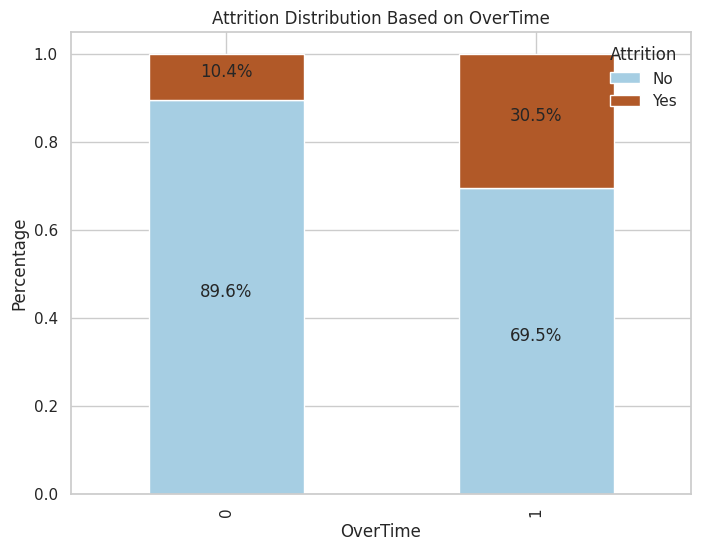

In [ ]:

# Calculate the percentage of attrition for each OverTime category
attrition_percentage = (
    dft.groupby(['OverTime', 'Attrition']).size() /
    dft.groupby(['OverTime']).size()
).reset_index(name='Percentage')

# Pivot the DataFrame to prepare for plotting
pivot_df = attrition_percentage.pivot(index='OverTime', columns='Attrition', values='Percentage').fillna(0)

# Create a stacked bar plot with percentage labels
ax = pivot_df.plot(kind='bar', stacked=True, figsize=(8, 6), colormap='Paired')

# Add percentage labels to the bars
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    ax.annotate(f'{height:.1%}', (x + width / 2, y + height / 2), ha='center')

# Customize the plot
plt.title("Attrition Distribution Based on OverTime")
plt.xlabel("OverTime")
plt.ylabel("Percentage")
plt.legend(title="Attrition", loc="upper right", labels=["No", "Yes"])

# Show the plot
plt.show()

Rasio karyawan yang Attrition sebesar 30% dari total karyawan dengan OverTime Yes. Maka, rekomendasi yang dapat kami berikan adalah evaluasi beban kerja lembur dan kompensasi/upah lembur karyawan. Evaluasi mungkin akan menghasilkan output kenaikan upah lembur atau pengurangan lembur.

### **3. StockOptionLevel**

The term **Employee Stock Option (ESO)** refers to a type of equity compensation granted by companies to their employees and executives.

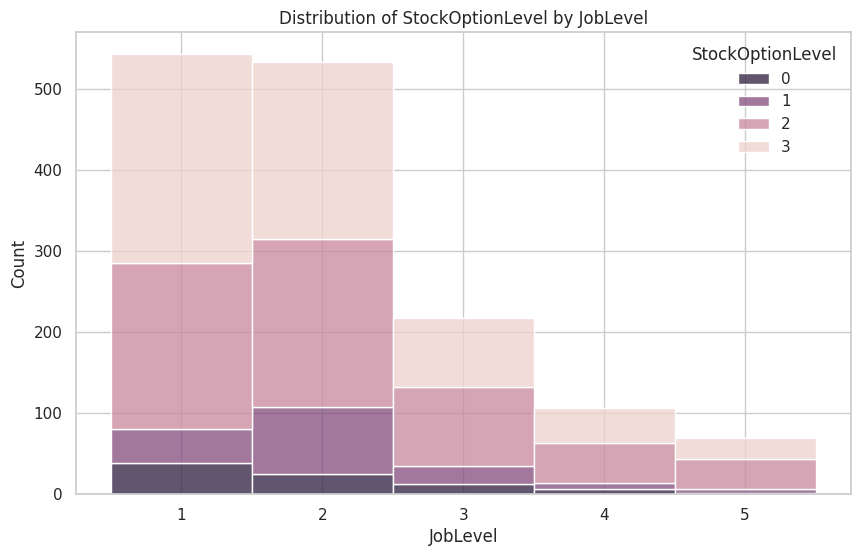

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a histogram to visualize the distribution
plt.figure(figsize=(10, 6))
sns.histplot(data=dft, x='JobLevel', hue='StockOptionLevel', discrete=True, multiple='stack')

# Customize the plot
plt.title("Distribution of StockOptionLevel by JobLevel")
plt.xlabel("JobLevel")
plt.ylabel("Count")
plt.legend(title="StockOptionLevel", loc="upper right", labels=[0, 1, 2, 3])

# Show the plot
plt.show()

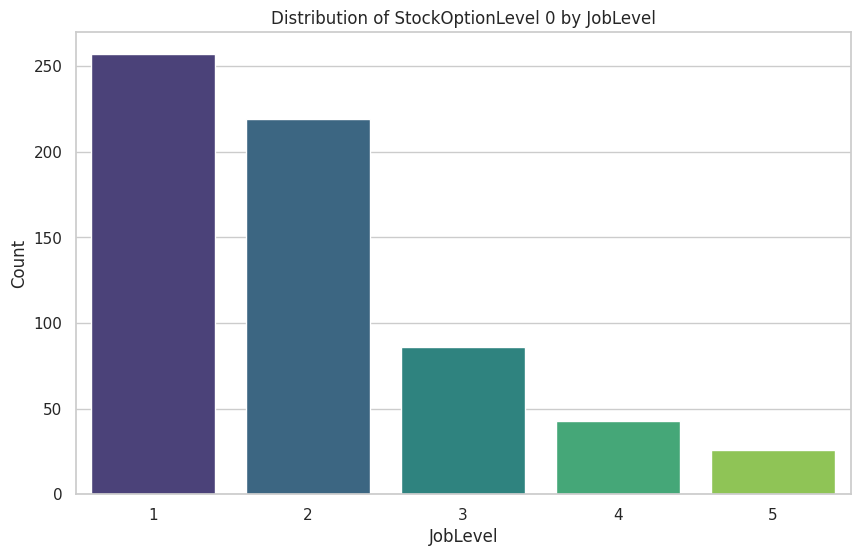

In [ ]:

import matplotlib.pyplot as plt
import seaborn as sns

# Filter the DataFrame for StockOptionLevel 0
stock_option_level_0 = dft[dft['StockOptionLevel'] == 0]

# Create a count plot to visualize the distribution
plt.figure(figsize=(10, 6))
sns.countplot(data=stock_option_level_0, x='JobLevel', palette='viridis')

# Customize the plot
plt.title("Distribution of StockOptionLevel 0 by JobLevel")
plt.xlabel("JobLevel")
plt.ylabel("Count")

# Show the plot
plt.show()

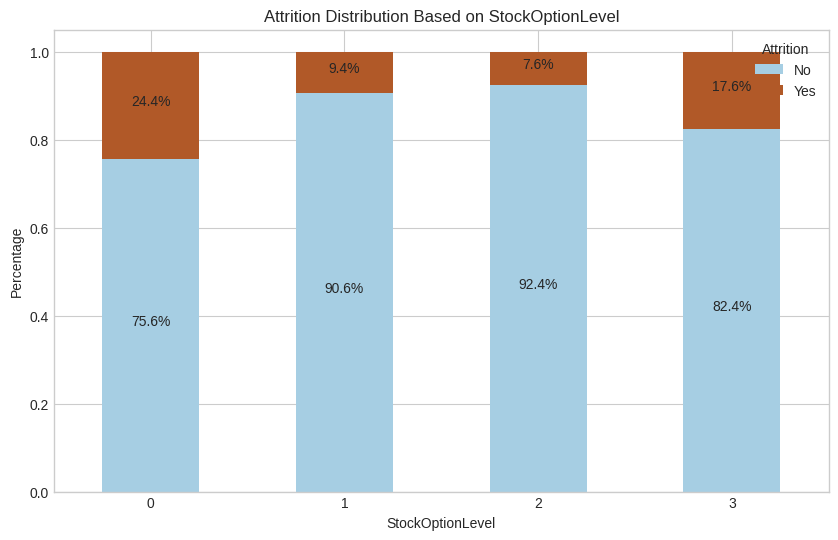

In [9]:
# Calculate the percentage of attrition for each Department category
attrition_percentage = (
    dft.groupby(['StockOptionLevel', 'Attrition']).size() /
    dft.groupby(['StockOptionLevel']).size()
).reset_index(name='Percentage')

# Pivot the DataFrame to prepare for plotting
pivot_df = attrition_percentage.pivot(index='StockOptionLevel', columns='Attrition', values='Percentage').fillna(0)

# Create a stacked bar plot with percentage labels
ax = pivot_df.plot(kind='bar', stacked=True, figsize=(10, 6), colormap='Paired')

# Add percentage labels to the bars
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    ax.annotate(f'{height:.1%}', (x + width / 2, y + height / 2), ha='center')

# Customize the plot
plt.title("Attrition Distribution Based on StockOptionLevel")
plt.xlabel("StockOptionLevel")
plt.ylabel("Percentage")
plt.legend(title="Attrition", loc="upper right", labels=["No", "Yes"])

# Rotate the x-axis labels horizontally
ax.set_xticklabels(ax.get_xticklabels(), rotation=0)

# Show the plot
plt.show()


Dapat dilihat bahwa karyawan mengalami attrition tertinggi pada StockOption level 0, begitupun dengan karyawan yang memiliki Stockoption level 0 tersebar paling banyak di job level 1 (paling rendah). Perusahaan dapat mengkaji terkait pembelian saham untuk karyawan yang masih di job level 1. Hal ini sesuai dengan Elsevier (2017) : "One potential approach to reduce turnover is to provide the employee with unvested compensation so that he forfeits some wealth if he leaves the firm prior to the vesting date. Unvested stock options can be particularly useful, as they are likely to be worth more when the employee’s outside opportunities are most attractive

### **4. Department R&D**

In [ ]:
# Calculate the number of attrition employees in each department
attrition_counts = dft[dft['Attrition'] == 1]['Department'].value_counts()

# Display the attrition counts for each department
print("Jumlah Attrition Karyawan Berdasarkan Departemen:")
attrition_counts

Jumlah Attrition Karyawan Berdasarkan Departemen:


Research & Development    133
Sales                      92
Human Resources            12
Name: Department, dtype: int64

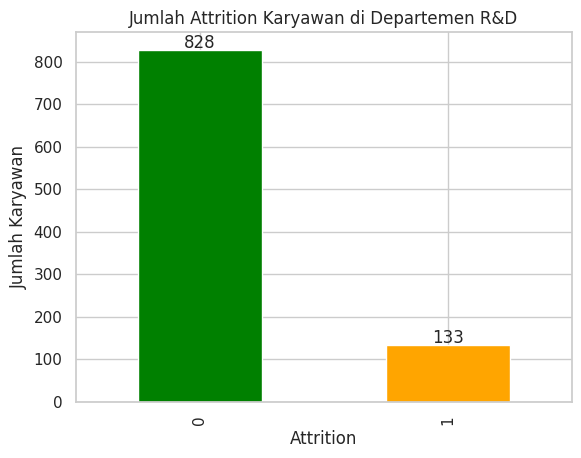

In [ ]:
# Filter data for employees in the "Research & Development" department
rd_department = dft[dft['Department'] == 'Research & Development']

# Calculate the number of "Yes" attrition and "No" attrition in the Research & Development department
attrition_counts = rd_department['Attrition'].value_counts()

# Create a bar chart to visualize the comparison
ax = attrition_counts.plot(kind='bar', color=['green', 'orange'])

# Add labels and title to the chart
plt.xlabel('Attrition')
plt.ylabel('Jumlah Karyawan')
plt.title('Jumlah Attrition Karyawan di Departemen R&D')

# Add text labels with the counts above each bar
for i, count in enumerate(attrition_counts):
    ax.text(i, count + 5, str(count), ha='center')

# Display the chart
plt.show()

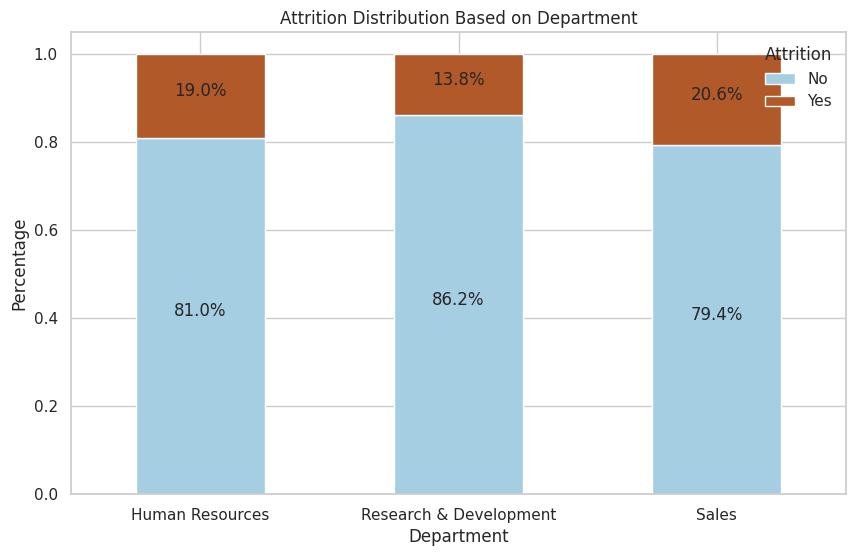

In [ ]:
# Calculate the percentage of attrition for each Department category
attrition_percentage = (
    dft.groupby(['Department', 'Attrition']).size() /
    dft.groupby(['Department']).size()
).reset_index(name='Percentage')

# Pivot the DataFrame to prepare for plotting
pivot_df = attrition_percentage.pivot(index='Department', columns='Attrition', values='Percentage').fillna(0)

# Create a stacked bar plot with percentage labels
ax = pivot_df.plot(kind='bar', stacked=True, figsize=(10, 6), colormap='Paired')

# Add percentage labels to the bars
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    ax.annotate(f'{height:.1%}', (x + width / 2, y + height / 2), ha='center')

# Customize the plot
plt.title("Attrition Distribution Based on Department")
plt.xlabel("Department")
plt.ylabel("Percentage")
plt.legend(title="Attrition", loc="upper right", labels=["No", "Yes"])

# Rotate the x-axis labels horizontally
ax.set_xticklabels(ax.get_xticklabels(), rotation=0)

# Show the plot
plt.show()

Secara jumlah, Departemen Research & Development adalah departemen dengan karyawan Attrition terbanyak (133 karyawan dari total 237 karyawan Attrition Yes). Namun, secara rasio adalah yang terendah dibandingkan dua departemen lainnya. Untuk itu, perusahaan dapat melakukan komparasi karakteristik karyawan yang berpotensi attrition dengan karyawan yang tidak attrition pada departemen ini. Hal ini dimaksudkan agar dapat menekan jumlah attrition karyawan dan rasio attrition tidak bertambah.

### **5. MaritalStatus_Married**

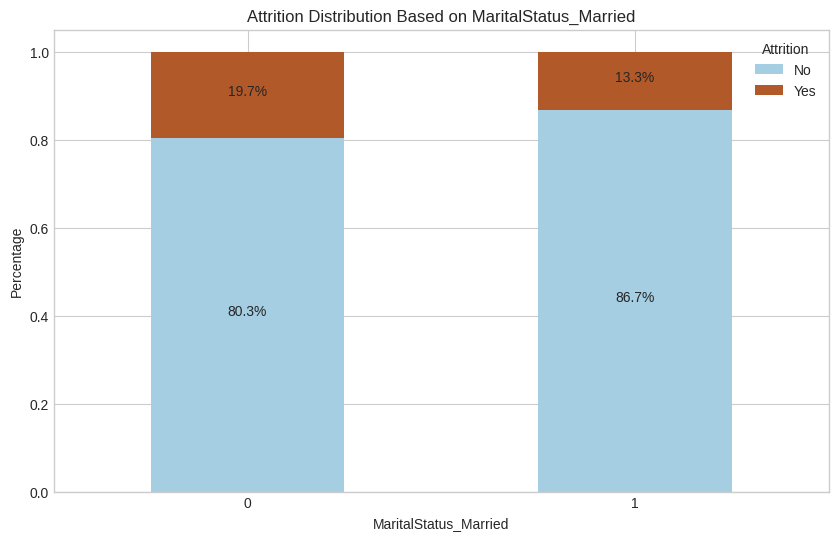

In [ ]:
# Calculate the percentage of attrition for each MaritalStatus_Married category
attrition_percentage = (
    df.groupby(['MaritalStatus_Married', 'Attrition']).size() /
    df.groupby(['MaritalStatus_Married']).size()
).reset_index(name='Percentage')

# Pivot the DataFrame to prepare for plotting
pivot_df = attrition_percentage.pivot(index='MaritalStatus_Married', columns='Attrition', values='Percentage').fillna(0)

# Create a stacked bar plot with percentage labels
ax = pivot_df.plot(kind='bar', stacked=True, figsize=(10, 6), colormap='Paired')

# Add percentage labels to the bars
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    ax.annotate(f'{height:.1%}', (x + width / 2, y + height / 2), ha='center')

# Customize the plot
plt.title("Attrition Distribution Based on MaritalStatus_Married")
plt.xlabel("MaritalStatus_Married")
plt.ylabel("Percentage")
plt.legend(title="Attrition", loc="upper right", labels=["No", "Yes"])

# Rotate the x-axis labels horizontally
ax.set_xticklabels(ax.get_xticklabels(), rotation=0)

# Show the plot
plt.show()

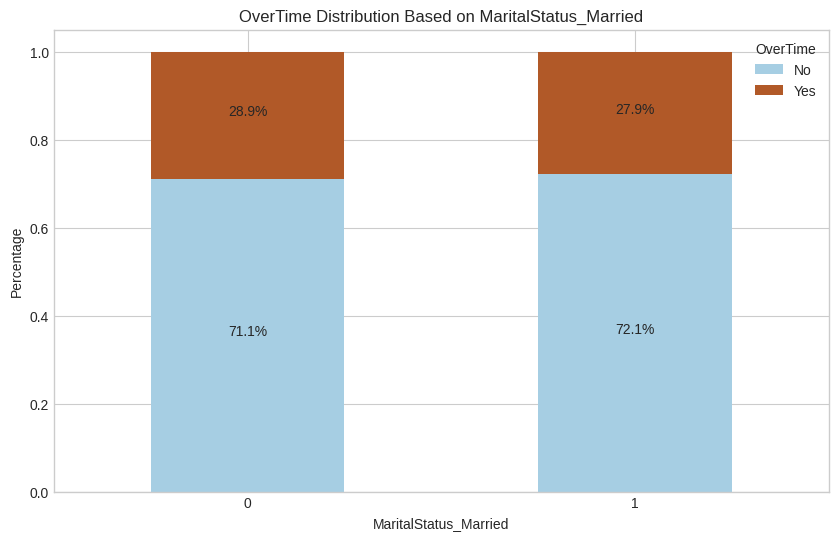

In [ ]:
# Calculate the percentage of attrition for each MaritalStatus_Married category
attrition_percentage = (
    df.groupby(['MaritalStatus_Married', 'OverTime']).size() /
    df.groupby(['MaritalStatus_Married']).size()
).reset_index(name='Percentage')

# Pivot the DataFrame to prepare for plotting
pivot_df = attrition_percentage.pivot(index='MaritalStatus_Married', columns='OverTime', values='Percentage').fillna(0)

# Create a stacked bar plot with percentage labels
ax = pivot_df.plot(kind='bar', stacked=True, figsize=(10, 6), colormap='Paired')

# Add percentage labels to the bars
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    ax.annotate(f'{height:.1%}', (x + width / 2, y + height / 2), ha='center')

# Customize the plot
plt.title("OverTime Distribution Based on MaritalStatus_Married")
plt.xlabel("MaritalStatus_Married")
plt.ylabel("Percentage")
plt.legend(title="OverTime", loc="upper right", labels=["No", "Yes"])

# Rotate the x-axis labels horizontally
ax.set_xticklabels(ax.get_xticklabels(), rotation=0)

# Show the plot
plt.show()



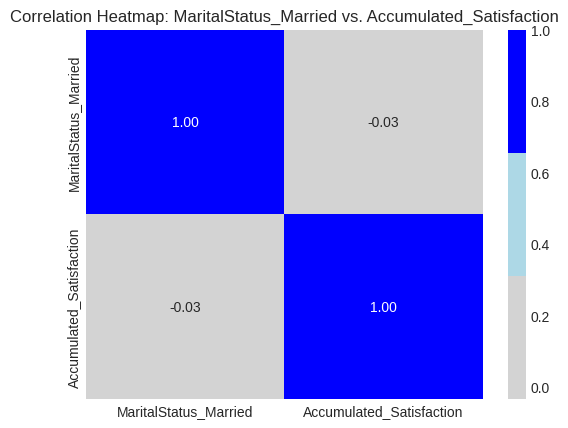

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

# Create a correlation matrix
correlation_matrix = df[['MaritalStatus_Married', 'Accumulated_Satisfaction']].corr()

# Create a custom color map with a softer color for the correlation value 1.00
cmap = ListedColormap(['lightgray', 'lightblue', 'blue'])

# Create a heatmap to visualize the correlation
sns.heatmap(correlation_matrix, annot=True, cmap=cmap, fmt=".2f")

# Add title
plt.title('Correlation Heatmap: MaritalStatus_Married vs. Accumulated_Satisfaction')

# Display the heatmap
plt.show()

Dapat dilihat bahwa terdapat sekitar 13 persen karyawan yang berstatus masih menikah cendrung untuk attrition. Ditinjau dari korelasi antara maritalstatus_married dengan accumulated_satisfaction juga berkorelasi negatif. Masih terdapat sekitar 28 persen karyawan yang married masih overtime diperusahaan tersebut. Berdasarkan Lai meng lee (2023),The employees who devoted too much time to their workplace and have insufficient time for family tend to leave their job. Sehingga perusahaan perlu meninjau lagi kebijakan untuk karyawan yang sudah menikah.

### **6. Age**

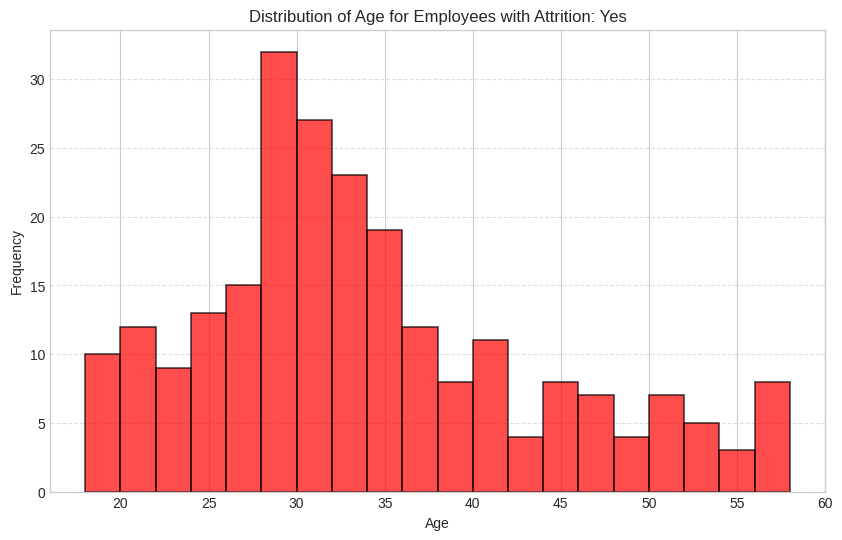

In [ ]:
import matplotlib.pyplot as plt

# Filter the data to include only employees with Attrition: Yes
attrition_yes = dft[dft['Attrition'] == 1]

# Create a histogram for Age for employees with Attrition: Yes
plt.figure(figsize=(10, 6))
plt.hist(attrition_yes['Age'], bins=20, color='red', alpha=0.7, edgecolor='k', linewidth=1.2)

# Add gridlines to separate each bar
plt.grid(axis='y', linestyle='--', alpha=0.6)

# Add labels and title to the chart
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.title('Distribution of Age for Employees with Attrition: Yes')

# Display the chart
plt.show()




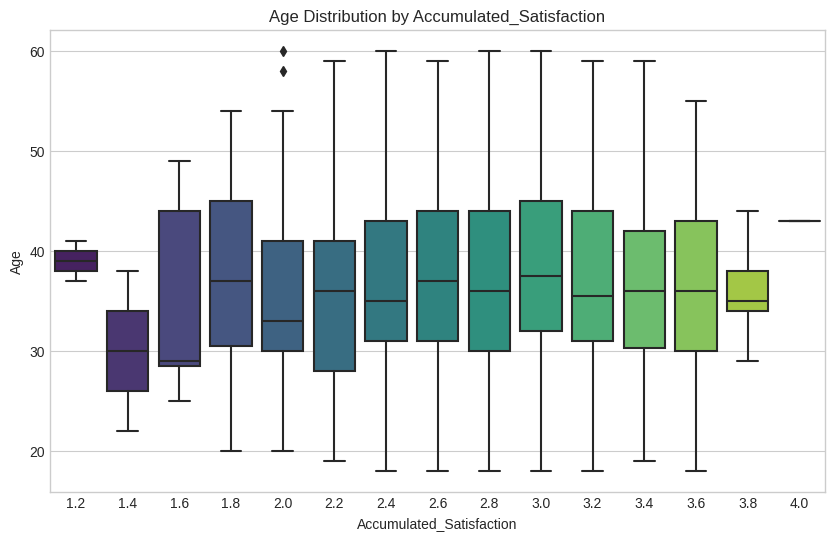

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a box plot for Age by JobLevel
plt.figure(figsize=(10, 6))
sns.boxplot(x='Accumulated_Satisfaction', y='Age', data=df, palette='viridis')

# Add labels and title to the chart
plt.xlabel('Accumulated_Satisfaction')
plt.ylabel('Age')
plt.title('Age Distribution by Accumulated_Satisfaction')

# Display the chart
plt.show()


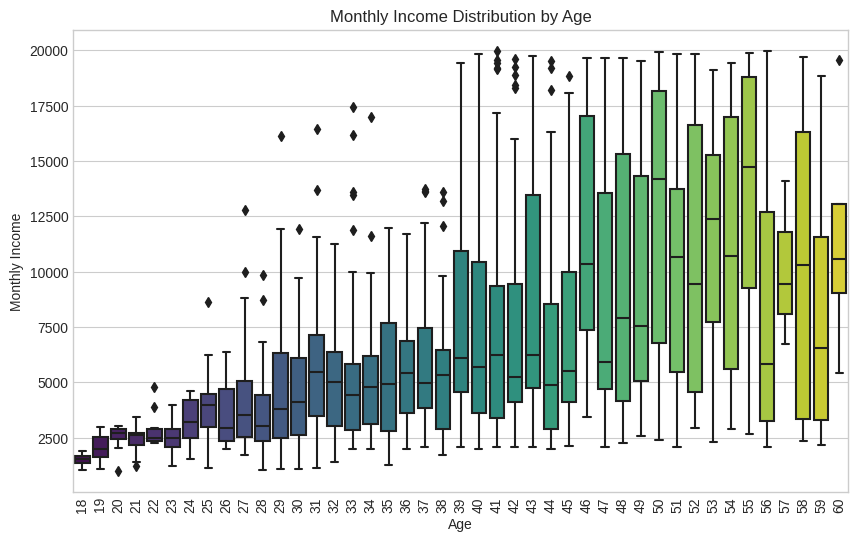

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a box plot for MonthlyIncome by Age
plt.figure(figsize=(10, 6))
sns.boxplot(x='Age', y='MonthlyIncome', data=df, palette='viridis')

# Add labels and title to the chart
plt.xlabel('Age')
plt.ylabel('Monthly Income')
plt.title('Monthly Income Distribution by Age')

# Rotate x-axis labels for better readability
plt.xticks(rotation=90)

# Display the chart
plt.show()


Dapat dilihat bahwa rentang umur 25-35, karyawan cendrung untuk melakukan attrition. Dapat dilihat juga bahwa satisfaction rendah (1.4) dan mothly income yang cukup rendah juga tersebar di umur tersebut. Hal ini dijuga didasari oleh Yousuf Khan (2019), Centennials and Millennials (born after 1995) choose to work for an organization that can provide them career growth and opportunities. Compensation also tops their list for leaving the company.

Perusahaan dapat meninjau terkait monthly income dan satisfaction sesuai dengan rekomendasi intervensi sebelumnya. Selain itu perusahaan juga perlu menyiapkan calon karyawan baru sebagai pengganti karyawan yang akan memasuki masa pensiun (diatas 50 tahun).

## **References**

---

